# Final Project: Olist E-commerce
### Abhilasha Bhuraria, Leo Bruell, Tatyana Rocha Peixoto, Moses Wajsman

## Customer Segmentation



### Olist - a Brazilian eCommerce Startup has hired our consulting team to help it solve a problem. Despite fundraising over 100M to support its growth, Olist is still burning cash on customer aquisition strategies and is concerned that they are not able to retain customers. 

Our first step in improving Olist's customer retention strategy is to understand the current situation. To do this, we will perform several customer segmentation analyses - cohort analysis and RFM segmentation.

In [75]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import geopandas as gpd
import warnings
import seaborn as sns
from operator import attrgetter
import matplotlib.colors as mcolors
import datetime


I downloaded the following data: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce

In [2]:
df_customers = pd.read_csv('Final_Project_Data/olist_customers_dataset.csv') 
df_geolocation = pd.read_csv('Final_Project_Data/olist_geolocation_dataset.csv') 
df_order_items = pd.read_csv('Final_Project_Data/olist_order_items_dataset.csv') 
df_order_payments = pd.read_csv('Final_Project_Data/olist_order_payments_dataset.csv') 
df_order_reviews = pd.read_csv('Final_Project_Data/olist_order_reviews_dataset.csv') 
df_orders = pd.read_csv('Final_Project_Data/olist_orders_dataset.csv') 
df_products = pd.read_csv('Final_Project_Data/olist_products_dataset.csv') 
df_sellers = pd.read_csv('Final_Project_Data/olist_sellers_dataset.csv') 
df_product_catname_translation = pd.read_csv('Final_Project_Data/product_category_name_translation.csv') 

In [12]:
#First we need to create a column that attaches a customer's unique ID to each purchase.
df_all_orders = pd.merge(df_orders,df_customers[['customer_id','customer_unique_id']],on='customer_id', how='left')


In [13]:
df_all_orders = pd.merge(df_all_orders,df_order_items[['order_id','price']],on='order_id', how='left')

In [15]:
df_all_orders.dropna(subset=['customer_unique_id'], inplace=True)

In [16]:
df_all_orders.describe().transpose()
#We can see that there are no negative numbers listed here - which means no returns are shown

,count,mean,std,min,25%,50%,75%,max
price,112650.0,120.653739,183.633928,0.85,39.9,74.99,134.9,6735.0


In [17]:
n_orders = df_all_orders.groupby(['customer_unique_id'])['order_id'].nunique()
mult_orders_perc = np.sum(n_orders > 1) / df_all_orders['customer_unique_id'].nunique()
print(f'{100 * mult_orders_perc:.2f}% of customers ordered more than once.')

3.12% of customers ordered more than once.


### In 100,000 orders, we see that only 3.12% of customers ordered more than once. Here is a visual to illustrate.

/Users/tatyanakortava/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning: `distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).
  warnings.warn(msg, FutureWarning)


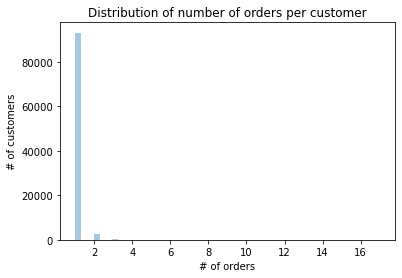

In [18]:
ax = sns.distplot(n_orders, kde=False, hist=True)
ax.set(title='Distribution of number of orders per customer',
       xlabel='# of orders', 
       ylabel='# of customers');

### In an effort to visualize the dropoff - we will show a cohort analysis. We will segment customers into time cohorts based on the time they made their first purchase, and will try to understand when they drop off. 

In [19]:
df_all_orders['order_purchase_timestamp'] = pd.to_datetime(df_all_orders['order_purchase_timestamp'])

In [20]:
def get_month(x): return datetime.datetime(x.year,x.month,1)
    
df_all_orders['order_month'] = df_all_orders['order_purchase_timestamp'].apply(get_month)

In [23]:
grouping = df_all_orders.groupby('customer_unique_id')['order_month']
df_all_orders['cohort_month'] = grouping.transform('min')
df_all_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,price,order_month,cohort_month
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,29.99,2017-10-01,2017-09-01
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,118.70,2018-07-01,2018-07-01
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,159.90,2018-08-01,2018-08-01
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,7c142cf63193a1473d2e66489a9ae977,45.00,2017-11-01,2017-11-01
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,72632f0f9dd73dfee390c9b22eb56dd6,19.90,2018-02-01,2018-02-01


In [24]:
#We will now to add a column that calculates the number of months between any transaction and the first ever transaction of each customer
def get_date_int(df,column):
    year = df[column].dt.year
    month = df[column].dt.month
    day = df[column].dt.day
    return year,month,day

In [25]:
order_year,order_month,_ = get_date_int(df_all_orders,'order_month')
cohort_year,cohort_month,_ = get_date_int(df_all_orders,'cohort_month') 
years_difference = order_year - cohort_year
months_difference = order_month - cohort_month
df_all_orders['cohort_index'] = years_difference*12+ months_difference+1
df_all_orders.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,price,order_month,cohort_month,cohort_index
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,29.99,2017-10-01,2017-09-01,2
1,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,118.70,2018-07-01,2018-07-01,1
2,47770eb9100c2d0c44946d9cf07ec65d,41ce2a54c0b03bf3443c3d931a367089,delivered,2018-08-08 08:38:49,2018-08-08 08:55:23,2018-08-08 13:50:00,2018-08-17 18:06:29,2018-09-04 00:00:00,3a653a41f6f9fc3d2a113cf8398680e8,159.90,2018-08-01,2018-08-01,1
3,949d5b44dbf5de918fe9c16f97b45f8a,f88197465ea7920adcdbec7375364d82,delivered,2017-11-18 19:28:06,2017-11-18 19:45:59,2017-11-22 13:39:59,2017-12-02 00:28:42,2017-12-15 00:00:00,7c142cf63193a1473d2e66489a9ae977,45.00,2017-11-01,2017-11-01,1
4,ad21c59c0840e6cb83a9ceb5573f8159,8ab97904e6daea8866dbdbc4fb7aad2c,delivered,2018-02-13 21:18:39,2018-02-13 22:20:29,2018-02-14 19:46:34,2018-02-16 18:17:02,2018-02-26 00:00:00,72632f0f9dd73dfee390c9b22eb56dd6,19.90,2018-02-01,2018-02-01,1


In [26]:
#Calculate the number of monthly active customers in each cohort
grouping_MAU = df_all_orders.groupby(['cohort_month','cohort_index'])
#Count the number of customers in each group
cohort_data = grouping_MAU['customer_unique_id'].apply(pd.Series.nunique)
#Then reset the index and create a pandas pivot table with cohort month as the rows, cohort index in the columns, and unique customer_id counts as values
cohort_data = cohort_data.reset_index()
cohort_counts = cohort_data.pivot(index = 'cohort_month',columns = 'cohort_index',values = 'customer_unique_id')
#Here is our table
cohort_counts

cohort_index,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,20,21
cohort_month,,,,,,,,,,,,,,,,,,,,
2016-09-01,4.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-10-01,321.0,NaN,NaN,NaN,NaN,NaN,1.0,NaN,NaN,1.0,NaN,1.0,NaN,1.0,NaN,1.0,NaN,1.0,2.0,2.0
2016-12-01,1.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-01,764.0,3.0,2.0,1.0,3.0,1.0,4.0,1.0,1.0,NaN,3.0,1.0,6.0,3.0,1.0,1.0,2.0,3.0,1.0,NaN
2017-02-01,1752.0,4.0,5.0,2.0,7.0,2.0,4.0,3.0,3.0,4.0,2.0,5.0,3.0,3.0,2.0,1.0,1.0,4.0,NaN,NaN
2017-03-01,2636.0,13.0,10.0,10.0,9.0,4.0,4.0,8.0,9.0,2.0,10.0,4.0,6.0,3.0,4.0,6.0,2.0,4.0,NaN,NaN
2017-04-01,2352.0,14.0,5.0,4.0,8.0,6.0,8.0,7.0,7.0,4.0,6.0,2.0,2.0,1.0,2.0,2.0,5.0,NaN,NaN,NaN
2017-05-01,3596.0,18.0,18.0,14.0,11.0,12.0,15.0,6.0,9.0,11.0,9.0,12.0,9.0,1.0,7.0,9.0,NaN,NaN,NaN,NaN
2017-06-01,3139.0,15.0,11.0,13.0,8.0,12.0,12.0,7.0,4.0,7.0,10.0,11.0,5.0,4.0,6.0,NaN,NaN,NaN,NaN,NaN


In [27]:
cohort_data

,cohort_month,cohort_index,customer_unique_id
0,2016-09-01,1,4
1,2016-10-01,1,321
2,2016-10-01,7,1
3,2016-10-01,10,1
4,2016-10-01,12,1
...,...,...,...
220,2018-08-01,1,6271
221,2018-08-01,2,7
222,2018-08-01,3,2
223,2018-09-01,1,5


In [28]:
#Now we will calculate the retention rate
#A side note - the first month's retention will be the same for all cohorts, this is because the number of active customers in the first month is the size of the cohort

#Select the first columns from the table and store it as cohort sizes
cohort_sizes = cohort_counts.iloc[:,0]

#Divide all values in the cohort_counts table but cohort sizes
#Set the axis parameter to zero to ensure that we are dividing along the "row" axis vs. the column "axis"
retention = cohort_counts.divide(cohort_sizes,axis=0)

#Round the ratio to 3 digits and multiply it by 100 to make it look like a percentage
retention.round(3)*100

#This is the retention rate table below

cohort_index,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,20,21
cohort_month,,,,,,,,,,,,,,,,,,,,
2016-09-01,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2016-10-01,100.0,NaN,NaN,NaN,NaN,NaN,0.3,NaN,NaN,0.3,NaN,0.3,NaN,0.3,NaN,0.3,NaN,0.3,0.6,0.6
2016-12-01,100.0,100.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2017-01-01,100.0,0.4,0.3,0.1,0.4,0.1,0.5,0.1,0.1,NaN,0.4,0.1,0.8,0.4,0.1,0.1,0.3,0.4,0.1,NaN
2017-02-01,100.0,0.2,0.3,0.1,0.4,0.1,0.2,0.2,0.2,0.2,0.1,0.3,0.2,0.2,0.1,0.1,0.1,0.2,NaN,NaN
2017-03-01,100.0,0.5,0.4,0.4,0.3,0.2,0.2,0.3,0.3,0.1,0.4,0.2,0.2,0.1,0.2,0.2,0.1,0.2,NaN,NaN
2017-04-01,100.0,0.6,0.2,0.2,0.3,0.3,0.3,0.3,0.3,0.2,0.3,0.1,0.1,0.0,0.1,0.1,0.2,NaN,NaN,NaN
2017-05-01,100.0,0.5,0.5,0.4,0.3,0.3,0.4,0.2,0.3,0.3,0.3,0.3,0.3,0.0,0.2,0.3,NaN,NaN,NaN,NaN
2017-06-01,100.0,0.5,0.4,0.4,0.3,0.4,0.4,0.2,0.1,0.2,0.3,0.4,0.2,0.1,0.2,NaN,NaN,NaN,NaN,NaN


### We can see that the retention rate is very low, and plummets to 1% or below in the second month after a customer orders.

In [30]:
#Least expensive order
df_all_orders['price'].min()

0.85

In [31]:
#Most expensive order
df_all_orders['price'].max()

6735.0

In [32]:
#Last day of orders
end_date = df_all_orders['order_month'].max()
end_date

Timestamp('2018-10-01 00:00:00')

In [33]:
start_date = df_all_orders['order_month'].min()

In [34]:
(end_date - start_date)/4

Timedelta('190 days 00:00:00')

In [58]:
df_all_orders['cohort_month']= (df_all_orders['cohort_month']).dt.strftime('%d-%m-%Y')

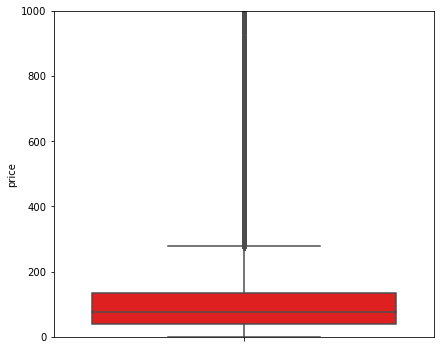

In [59]:
#Box and whisker plot of price distribtions
plt.figure(figsize=(15,6))
plt.subplot(1,2,2)
plt.ylim(0, 1000)
sns.boxplot(y=df_all_orders['price'], color="red")
plt.show()

In [60]:
#Now that we have retention rate, lets calculate the average spend per cohort

average_amount_grouping = df_all_orders.groupby(['cohort_month','cohort_index'])
cohort_spend_data = average_amount_grouping['price'].mean()
# Reset the index before creating a pivot table
cohort_spend_data = cohort_spend_data.reset_index()
#Create a pivot table 
average_spend = cohort_spend_data.pivot(index = 'cohort_month',columns = 'cohort_index',values = 'price')
average_spend.round(1)

cohort_index,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,20,21
cohort_month,,,,,,,,,,,,,,,,,,,,
01-01-2017,126.1,41.6,41.4,75.0,66.6,60.0,74.6,39.9,25.9,NaN,124.4,49.0,76.0,99.6,24.0,89.9,82.0,106.6,38.0,NaN
01-01-2018,115.6,107.5,84.7,101.7,102.0,100.3,64.4,81.2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
01-02-2017,126.9,119.6,80.8,44.6,122.3,25.0,116.8,78.3,190.9,51.2,159.4,76.6,90.0,93.3,71.9,117.0,125.9,54.9,NaN,NaN
01-02-2018,110.6,99.1,85.1,122.7,62.0,170.4,103.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
01-03-2017,124.8,78.6,145.2,137.1,98.9,326.7,118.7,92.2,111.6,103.2,87.3,76.5,134.2,56.3,123.5,86.9,77.4,77.1,NaN,NaN
01-03-2018,120.5,105.8,103.5,121.8,133.2,46.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
01-04-2017,134.7,155.2,133.4,134.2,171.7,149.5,107.8,93.4,122.8,109.9,70.8,66.1,224.4,252.0,128.9,70.6,177.3,NaN,NaN,NaN
01-04-2018,125.6,97.7,102.2,68.5,67.5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
01-05-2017,122.2,68.7,98.7,92.7,99.0,80.9,149.0,92.1,115.2,67.9,84.6,77.2,98.9,46.9,57.9,49.4,NaN,NaN,NaN,NaN


### Interestingly, despite a massive dropoff in customers, those who do remain tend to spend the same amount on average as they did before. If Olist can find a way to capture these customers and keep them coming back, it will likely be able to rely on their reoccuring revenue. 

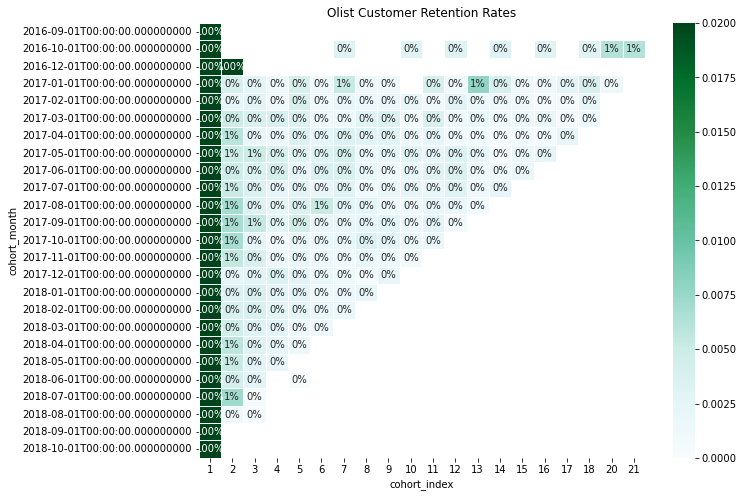

In [63]:
retention.round(3)*100
plt.figure(figsize=(10,8))
plt.title('Olist Customer Retention Rates')
s = sns.heatmap(data = retention,
            annot = True,
            fmt  = '.00%',
            cmap = 'BuGn',
            vmin = 0.0,
            vmax = 0.02,
            linewidth=1.0,
            )
plt.show()

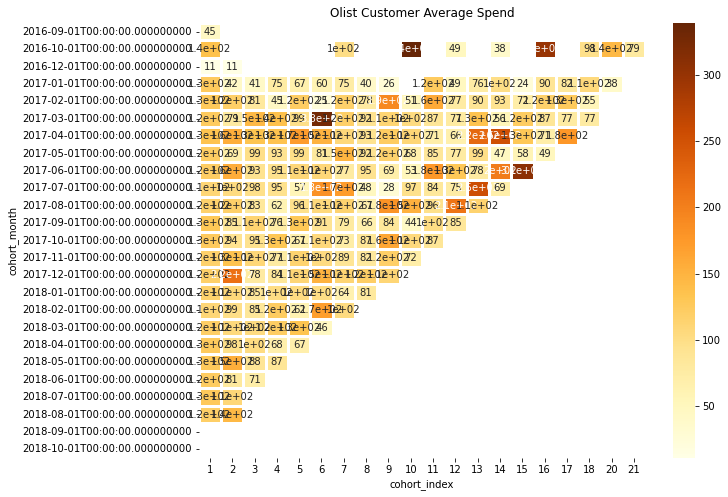

In [38]:
plt.figure(figsize=(10,8))
plt.title('Olist Customer Average Spend')
sns.heatmap(data = average_spend,
            annot = True,
            cmap = 'YlOrBr',
            linewidth=3.0)
plt.show()

### After performing a cohort analysis above to understand how consumers behave over time, lets do a Recency, Frequency, Monetary segmentation.
- Recency : how recent was each customers last purchase
- Frequency : how many purchases has the customer done in the last twelve months
- Monetary Value: how much the customer has spent in the last twelve months

Is there a correlation between Recency, Frequency, and Monetary Value?

How should we define our most valuable customers (MVC)? What percentage of our customers are the most valuable customers?

Are we able to create distinguishing segments and design CRM campaigns accordingly to improve customer engagement and/or monetization?

In [78]:
#Create the RFM table

#Find the latest date
last = df_all_orders['order_purchase_timestamp'].max()
last
Last_Order_Day = datetime.date(2018,10,17)

#Convert order_purchase_timestamp to date format.
df_all_orders['last_order_day'] = pd.to_datetime(df_all_orders['order_purchase_timestamp']).dt.date


In [79]:
## RFM Table
RFM_table=df_all_orders.groupby('customer_unique_id').agg({'last_order_day': lambda x: (Last_Order_Day - x.max()).days, # Recency
                                                'order_id': lambda x: len(x.unique()), # Frequency
                                                'price': lambda x: x.sum()})    # Monetary 
RFM_table['last_order_day'] = RFM_table['last_order_day'].astype(int)

RFM_table.rename(columns={'last_order_day': 'recency', 
                         'order_id': 'frequency',
                         'price': 'monetary_value'}, inplace=True)
RFM_table.tail()



,recency,frequency,monetary_value
customer_unique_id,,,
fffcf5a5ff07b0908bd4e2dbc735a684,496,1,1570.00
fffea47cd6d3cc0a88bd621562a9d061,311,1,64.89
ffff371b4d645b6ecea244b27531430a,617,1,89.90
ffff5962728ec6157033ef9805bacc48,168,1,115.00
ffffd2657e2aad2907e67c3e9daecbeb,533,1,56.99


In [42]:
#Verify that this table accounts for all unique customer IDs 
df_all_orders['customer_unique_id']. nunique() 

#It looks like the two values match!

96096

In [43]:
#Now lets make quantiles to separate the data
quantiles = RFM_table.quantile(q=[0.25,0.5,0.75])
quantiles

,recency,frequency,monetary_value
0.25,164.0,1.0,45.99
0.50,269.0,1.0,89.00
0.75,397.0,1.0,154.00


In [44]:
# Converting quantiles to a dictionary
quantiles = quantiles.to_dict()

In [45]:
##  RFM Segmentation
## For RFM it is important to assign quantiles to Recency separately from Frequency and Monetary values are more recent purchases are ranked better. 
RFM_Segment = RFM_table.copy()
# Arguments (x = value, p = recency, monetary_value, frequency, k = quartiles dict)
def R_Class(x,p,d):
    if x <= d[p][0.25]:
        return 4
    elif x <= d[p][0.50]:
        return 3
    elif x <= d[p][0.75]: 
        return 2
    else:
        return 1

In [46]:
# Arguments (x = value, p = recency, monetary_value, frequency, k = quartiles dict)
def FM_Class(x,p,d):
    if x <= d[p][0.25]:
        return 1
    elif x <= d[p][0.50]:
        return 2
    elif x <= d[p][0.75]: 
        return 3
    else:
        return 4
RFM_Segment['R_Quartile'] = RFM_Segment['recency'].apply(R_Class, args=('recency',quantiles,))
RFM_Segment['F_Quartile'] = RFM_Segment['frequency'].apply(FM_Class, args=('frequency',quantiles,))
RFM_Segment['M_Quartile'] = RFM_Segment['monetary_value'].apply(FM_Class, args=('monetary_value',quantiles,))
RFM_Segment['RFMClass'] = RFM_Segment.R_Quartile.map(str) \
                            + RFM_Segment.F_Quartile.map(str) \
                            + RFM_Segment.M_Quartile.map(str)

In [81]:
#Which customers spend the most money and buy the most frequently?
#RFMClass = 444
RFM_Segment[RFM_Segment['RFMClass']=='444'].sort_values('monetary_value', ascending=False).head(5)

,recency,frequency,monetary_value,R_Quartile,F_Quartile,M_Quartile,RFMClass
customer_unique_id,,,,,,,
c8460e4251689ba205045f3ea17884a1,70,4,4080.00,4,4,4,444
46450c74a0d8c5ca9395da1daac6c120,61,3,3109.99,4,4,4,444
7b0eaf68a16e4808e5388c67345033c9,151,2,2238.42,4,4,4,444
906a8a4ec9f3d4c3e64fa6d1c4fe6009,89,2,1835.00,4,4,4,444
0341bbd5c969923a0f801b9e2d10a7b8,140,2,1828.44,4,4,4,444


In [48]:
#Which customers are at the verge of churning because they haven't purchased in a long time? AKA their recency is low
RFM_Segment[RFM_Segment['R_Quartile'] <= 2 ].sort_values('monetary_value', ascending=False).head(5)

,recency,frequency,monetary_value,R_Quartile,F_Quartile,M_Quartile,RFMClass
customer_unique_id,,,,,,,
0a0a92112bd4c708ca5fde585afaa872,383,1,13440.0,2,1,4,214
da122df9eeddfedc1dc1f5349a1a690c,564,2,7388.0,1,4,4,144
dc4802a71eae9be1dd28f5d788ceb526,612,1,6735.0,1,1,4,114
ff4159b92c40ebe40454e3e6a7c35ed6,511,1,6499.0,1,1,4,114
4007669dec559734d6f53e029e360987,327,1,5934.6,2,1,4,214


In [49]:
#Which customers should we not focus on, as both their recency, frequency and monetary value is low?
RFM_Segment[RFM_Segment['RFMClass']=='111'].sort_values('recency',ascending=False).head(5)



,recency,frequency,monetary_value,R_Quartile,F_Quartile,M_Quartile,RFMClass
customer_unique_id,,,,,,,
009b0127b727ab0ba422f6d9604487c7,764,1,0.00,1,1,1,111
2f64e403852e6893ae37485d5fcacdaf,744,1,21.90,1,1,1,111
61db744d2f835035a5625b59350c6b63,744,1,36.49,1,1,1,111
b8b8726af116a5cfb35b0315ecef9172,744,1,21.50,1,1,1,111
87776adb449c551e74c13fc34f036105,744,1,29.99,1,1,1,111


In [50]:
#Which are the customers with the highest frequency value?

RFM_Segment[RFM_Segment['F_Quartile'] >= 3 ].sort_values('frequency', ascending=False).head(5)

,recency,frequency,monetary_value,R_Quartile,F_Quartile,M_Quartile,RFMClass
customer_unique_id,,,,,,,
8d50f5eadf50201ccdcedfb9e2ac8455,58,17,729.62,4,4,4,444
3e43e6105506432c953e165fb2acf44c,232,9,1000.85,3,4,4,344
1b6c7548a2a1f9037c1fd3ddfed95f33,245,7,809.21,3,4,4,344
6469f99c1f9dfae7733b25662e7f1782,111,7,664.20,4,4,4,444
ca77025e7201e3b30c44b472ff346268,138,7,806.61,4,4,4,444


In [51]:
RFM_table.describe()

,recency,frequency,monetary_value
count,96096.000000,96096.000000,96096.000000
mean,288.108797,1.034809,141.438184
std,153.417869,0.214384,217.215904
min,0.000000,1.000000,0.000000
25%,164.000000,1.000000,45.990000
50%,269.000000,1.000000,89.000000
75%,397.000000,1.000000,154.000000
max,773.000000,17.000000,13440.000000


# Orders and revenue mapping

After completing the customer segmentation analysis, we next make some visualizations to try to better understand how orders vary by state. 

### 1. Loading Data and Creating DataFrames 

It is important to import the following packages in order to create the chloropleth. 

    A note on geopandas: geopandas is the package required to build chloropleths, it extends the datatypes used by pandas to allow spatial operations on geometric types. It does not come pre-installed with Anaconda, and needs to be installed separately. Here is the documentation to install geopandas: https://geopandas.org/en/stable/getting_started/install.html. I had to troubleshoot this process extensively and ended up using the pip install route as opposed to conda install.

In [1]:
#importing global libraries

import pandas as pd
import numpy as np
import geopandas as gpd

I downloaded the following data: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce

In [2]:
# loading all datasets, not all are used in this analysis

df_customers = pd.read_csv('./data/olist_customers_dataset.csv') 
df_geolocation = pd.read_csv('./data/olist_geolocation_dataset.csv') 
df_order_items = pd.read_csv('./data/olist_order_items_dataset.csv') 
df_order_payments = pd.read_csv('./data/olist_order_payments_dataset.csv') 
df_order_reviews = pd.read_csv('./data/olist_order_reviews_dataset.csv') 
df_orders = pd.read_csv('./data/olist_orders_dataset.csv') 
df_products = pd.read_csv('./data/olist_products_dataset.csv') 
df_sellers = pd.read_csv('./data/olist_sellers_dataset.csv') 
df_product_catname_translation = pd.read_csv('./data/product_category_name_translation.csv') 


# importing shapefile (source: https://www.ibge.gov.br/ )

df_map = gpd.read_file("./data/bcim_2016_shapefiles_21-11-2018/lim_unidade_federacao_a.shp")

In [3]:
## The column categories are in Brazilian Portuguese - however I can see that the column titled "sigla" matches the "state" in df.geolocation
## We should change the name in df_map to make it more clear
df_map.rename(columns={'sigla':'geolocation_state'},inplace = True)


In [4]:
##Now lets make sure that both df_map and df_geolocation have an equal amount of states
map_states = len(pd.unique(df_map['geolocation_state']))
print("No.of.unique values :", 
      map_states)

No.of.unique values : 27


In [5]:
map_states = len(pd.unique(df_geolocation['geolocation_state']))
print("No.of.unique values :", 
      map_states)
##Looks like we have a match!

No.of.unique values : 27


In [6]:
# merging order and customer data
df_merged = pd.merge(df_orders,
         df_customers,
         left_on='customer_id',
         right_on='customer_id',
         how='inner')

# adding in order payments information (essentially revenue per order)
df_merged = pd.merge(df_merged,
         df_order_payments,
         left_on='order_id',
         right_on='order_id',
         how='inner')

# filtering on orders that were actually delivered (not canceled, returned, etc.)
df_merged = df_merged[df_merged['order_status'] == 'delivered']

# filtering only on relevant columns for the analysis
df_merged = df_merged[
    ['order_purchase_timestamp',
     'customer_zip_code_prefix',
     'customer_state',
     'payment_value'
    ]
]

# translating dates into relevant formats to simplify creation of map sliders later
df_merged['order_purchase_timestamp'] = pd.to_datetime(df_merged['order_purchase_timestamp'])
df_merged['year'] = df_merged['order_purchase_timestamp'].dt.strftime('%Y')
df_merged['month'] = df_merged['order_purchase_timestamp'].dt.strftime('%m')
df_merged[['year','month']] = df_merged[['year','month']].astype(int)


# renaming state column to align to shapefile headers
df_merged = df_merged.rename(columns={'customer_state': 'geolocation_state'})

# final grouping to create dataset with total orders and revenue by state by year-month combo
df_grouped = df_merged.groupby(['year','month', 'geolocation_state']).agg({'order_purchase_timestamp': 'count', 'payment_value': 'sum'})

df_grouped = df_grouped.rename(columns={'order_purchase_timestamp': 'total_orders',
                                        'payment_value': 'total_revenue'
                                       }
                              )
df_grouped = df_grouped.reset_index()

# creating final merged dataset including geometry
brazil_ecommerce = pd.merge(df_grouped,
         df_map[['geolocation_state', 'geometry']],
         left_on='geolocation_state',
         right_on='geolocation_state',
         how='left')

# converting to geodataframe to ensure fit with shapefile
brazil_ecommerce = gpd.GeoDataFrame(brazil_ecommerce)

# adding log scale to total orders to ensure more gradation in shading, since
# two states in brazil dominate the order data

brazil_ecommerce['total_orders_log'] = np.log10(brazil_ecommerce['total_orders'])
brazil_ecommerce['total_revenue_log'] = np.log10(brazil_ecommerce['total_revenue'])

## 2. Building maps using bokeh

In [19]:
from bokeh.io import output_notebook, show
from bokeh.plotting import figure
from bokeh.models import GeoJSONDataSource, LinearColorMapper, HoverTool, Select, Slider, CustomJS
from bokeh.palettes import Spectral6
from bokeh.layouts import column, widgetbox
import json
from bokeh.models import ColorBar, BasicTicker


# convert the geodataframe to the appropriate CRS (helps ensure compatability with geojson)
brazil_ecommerce = brazil_ecommerce.to_crs(epsg='4326')

# simplify the shapefile geometry so that the file doesn't become huge
# high fidelity shapefiles (like this one) can bloat the final output
brazil_ecommerce.geometry = brazil_ecommerce.geometry.simplify(tolerance=0.01, preserve_topology=True)

# create a GeoJSONDataSource from the geometry column
geojson_data = brazil_ecommerce.to_json()
geojson_dict = json.loads(geojson_data)
geojson_dict['features'] = [f for f in geojson_dict['features'] if f['properties']['geolocation_state'] != 'EX']
geo_source = GeoJSONDataSource(geojson=json.dumps(geojson_dict))

# create a figure and add a patch glyph to render the states
fig = figure(title='Brazil Orders and Revenue By State', plot_width=800, plot_height=600)

# Create an initial color_mapper
color_mapper = LinearColorMapper(palette=Spectral6, low=brazil_ecommerce['total_orders_log'].min(), high=brazil_ecommerce['total_orders_log'].max())

states = fig.patches('xs', 'ys', source=geo_source, fill_color={'field': 'total_orders_log', 'transform': color_mapper}, line_color='black', line_width=0.5)

# create a select tool to switch between total_orders and total_revenue
select = Select(title='Data', value='total_orders_log', options=['total_orders_log', 'total_revenue_log'])

# create a year slider to control the year
year_slider = Slider(title='Year', start=2016, end=2018, step=1, value=int(brazil_ecommerce['year'].min()))

# create a month slider to control the month
month_slider = Slider(title='Month', start=1, end=12, step=1, value=int(brazil_ecommerce['month'].min()))

# create a callback to update the data shown on the map
callback = CustomJS(args=dict(geo_source=geo_source, brazil_ecommerce=geojson_dict, select=select, year_slider=year_slider, month_slider=month_slider, states=states, color_mapper=color_mapper), code="""
    const data = JSON.parse(geo_source.geojson);
    const selected_data = select.value;
    const selected_year = year_slider.value;
    const selected_month = month_slider.value;

    var filtered_data = brazil_ecommerce.features.filter(feature => (feature.properties.year == selected_year) && (feature.properties.month == selected_month));
    var values = filtered_data.map(feature => feature.properties[selected_data]);

    data.features.forEach(function(feature){
        feature.properties.data = null;
        feature.properties.total_orders = null;
        feature.properties.total_revenue = null;
    });

    filtered_data.forEach(function(filtered_feature){
        let state = filtered_feature.properties.geolocation_state;
        let value = filtered_feature.properties[selected_data];
        let orders = filtered_feature.properties.total_orders;
        let revenue = filtered_feature.properties.total_revenue;
        data.features.forEach(function(feature){
            if(feature.properties.geolocation_state == state){
                feature.properties.data = value;
                feature.properties.total_orders = orders;
                feature.properties.total_revenue = revenue;
            }
        });
    });

    color_mapper.low = Math.min(...values);
    color_mapper.high = Math.max(...values);

    states.glyph.fill_color = {'field': 'data', 'transform': color_mapper};

    geo_source.geojson = JSON.stringify(data);
    geo_source.change.emit();
""")

# hover tool
hover = HoverTool(tooltips=[
    ('State', '@geolocation_state'),
], renderers=[states], mode='mouse')
fig.add_tools(hover)

# add the callback to the select tool and slider
select.js_on_change('value', callback)
year_slider.js_on_change('value', callback)
month_slider.js_on_change('value',callback)

# create a layout with the map and the controls
layout = column(fig, widgetbox(select, year_slider, month_slider))

output_notebook()
show(layout)


Loading BokehJS ...

## Identifying basket of goods by state in Brazil

Determining what the top 5 items purchased are in each state of Brazil

Data source and schema: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce?select=olist_orders_dataset.csv

In [1]:
import pandas as pd

In [2]:
# reading datasets

df_orders = pd.read_csv('data/olist_orders_dataset.csv')
df_orderitems = pd.read_csv('data/olist_order_items_dataset.csv')
df_products = pd.read_csv('data/olist_products_dataset.csv')
df_customers = pd.read_csv('data/olist_customers_dataset.csv')
df_prodtrans = pd.read_csv('data/product_category_name_translation.csv')


In [3]:
# joining data sets to obtain a single data set that has product information and customer geolocation data
# for all customers and all orders
# merge orders data with orderitems dataset to get a combined dataset with order and items
# then merge with products data set to add actual product names
# then merge with customers data to add customer location

df_orderslong = df_orders.merge(df_orderitems[['order_id','product_id','seller_id']], how='left', on='order_id')
df_orderslong = df_orderslong.merge(df_products[['product_id','product_category_name']], how='left', on='product_id')
df_orderslong = df_orderslong.merge(df_customers, how='left', on='customer_id')
df_orderslong = df_orderslong.dropna()
df_orderslong = df_orderslong[df_orderslong['order_status'] == 'delivered']


In [4]:
# Identify the top product categories in each state

grouped = df_orderslong.groupby(['customer_state', 'product_category_name']).size().reset_index(name='count')

# Sort the data by 'customer_state' and the count in descending order
grouped = grouped.sort_values(['customer_state', 'count'], ascending=[True, False])

# Use groupby with 'customer_state' and head to get the top 15 product categories for each state
df_top5_product_categories = grouped.groupby('customer_state').head(15)

# Reset the index
df_top5_product_categories = df_top5_product_categories.reset_index(drop=True)

# translate product categories from portuguese to english
df_top5_product_categories = df_top5_product_categories.merge(df_prodtrans,
                                                              how='left',
                                                              left_on='product_category_name',
                                                              right_on='product_category_name'
                                                             )

# dropping the portuguese column
df_top5_product_categories = df_top5_product_categories.drop(columns='product_category_name')

In [5]:
from bokeh.io import output_notebook, show
from bokeh.layouts import column
from bokeh.models import ColumnDataSource, HoverTool, Select, CustomJS
from bokeh.palettes import Spectral11
from bokeh.plotting import figure
import json

# Set output to notebook
output_notebook()

# Sort the data by count in descending order for each state
df_top5_product_categories = df_top5_product_categories.sort_values(by=['customer_state', 'count'], ascending=[True, False])

# Group data by customer_state and select top 5 product categories for each state
data_by_state = df_top5_product_categories.groupby('customer_state', group_keys=False).apply(lambda x: x.head(15)).reset_index(drop=True)

# Set up the data source and plot for the initial state
initial_state = 'SP'
state_data = data_by_state[data_by_state['customer_state'] == initial_state]
categories = state_data['product_category_name_english'].tolist()
counts = state_data['count'].tolist()
source = ColumnDataSource(data=dict(categories=categories, counts=counts))
p = figure(y_range=categories, plot_width=600, plot_height=600,
           title=f'Top Selling Product Categories in {initial_state}')
p.hbar(y='categories', right='counts', height=0.5, source=source, color=Spectral11[0])
p.xaxis.axis_label = 'Count'
p.yaxis.axis_label = 'Product Category'
p.grid.grid_line_color = None
hover = HoverTool(tooltips=[('Category', '@categories'),
                            ('Count', '@counts')])
p.add_tools(hover)

data_by_state_json = data_by_state.to_json(orient='records')
data_by_state_dict = json.loads(data_by_state_json)

callback = CustomJS(args=dict(source=source, plot=p, data_by_state=data_by_state_dict), code="""
    const data = source.data;
    const state = cb_obj.value;
    const state_data = data_by_state.filter(obj => obj.customer_state == state)
        .sort((a, b) => b.count - a.count)
        .slice(0, 15);
    const categories = state_data.map(obj => obj.product_category_name_english);
    const counts = state_data.map(obj => obj.count);
    source.data = {categories: categories, counts: counts};
    plot.title.text = `Top Selling Product Categories in ${state}`;
    plot.y_range.factors = categories;
    plot.x_range.start = 0;
    plot.x_range.end = Math.max(...counts) * 1.1;
    source.change.emit();
""")

# Create a Select widget to choose the state
state_select = Select(title='State:', value=initial_state,
                      options=data_by_state['customer_state'].unique().tolist())
state_select.js_on_change('value', callback)

# Create a layout for the plot and Select widget
layout = column(state_select, p)

# Show the plot
show(layout)

Loading BokehJS ...

# Analysis of Olist's Customer Reviews

After completing the cohort analysis, we have a better understanding of the scale of the problem. Next, we analyze customer reviews to better understand why Olist customers are not buying more on the platform. 

In [1]:
# Standard libraries
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
from matplotlib.gridspec import GridSpec
pd.set_option('display.max_columns', 100)
import plotly.offline as py
import plotly.express as px
import plotly.graph_objs as go
import json
import requests
import folium
from folium.plugins import FastMarkerCluster, Fullscreen, MiniMap, HeatMap, HeatMapWithTime, LocateControl
from wordcloud import WordCloud
from collections import Counter
from PIL import Image

# Utilities
# from viz_utils import *
# from custom_transformers import *
# from ml_utils import *

# DataPrep
import re
from nltk.corpus import stopwords
from nltk.stem import RSLPStemmer
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.pipeline import Pipeline
import joblib

# Modeling
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.naive_bayes import GaussianNB
import lightgbm as lgb

ModuleNotFoundError: No module named 'wordcloud'

In [92]:
import nltk
nltk.download('rslp')

[nltk_data] Downloading package rslp to /Users/aa/nltk_data...
[nltk_data]   Unzipping stemmers/rslp.zip.


True

In [124]:
df_sellers = pd.read_csv('/Users/aa/Desktop/olist_sellers_dataset.csv') 
df_geolocation = pd.read_csv('/Users/aa/Desktop/olist_geolocation_dataset.csv') 
df_payments = pd.read_csv('/Users/aa/Desktop/olist_order_payments_dataset.csv') 
df_category = pd.read_csv('/Users/aa/Desktop/product_category_name_translation.csv') 
df_items = pd.read_csv('/Users/aa/Desktop/olist_order_items_dataset.csv') 
df_customers = pd.read_csv('/Users/aa/Desktop/olist_customers_dataset.csv') 
df_orders = pd.read_csv('/Users/aa/Desktop/olist_orders_dataset.csv') 
df_products = pd.read_csv('/Users/aa/Desktop/olist_products_dataset.csv') 
df_reviews = pd.read_csv('./Final_Project_Data/olist_order_reviews_dataset.csv')

### Creating a Comments Dataframe

In [4]:
df_comments = df_reviews.loc[:, ['review_score', 'review_comment_message']]
df_comments = df_comments.dropna(subset=['review_comment_message'])
df_comments = df_comments.reset_index(drop=True)
print(f'Dataset shape: {df_comments.shape}')
df_comments.columns = ['score', 'comment']
df_comments.head()

Dataset shape: (40977, 2)


,score,comment
0,5,Recebi bem antes do prazo estipulado.
1,5,Parabéns lojas lannister adorei comprar pela I...
2,4,aparelho eficiente. no site a marca do aparelh...
3,4,"Mas um pouco ,travando...pelo valor ta Boa.\r\n"
4,5,"Vendedor confiável, produto ok e entrega antes..."


### Formatting Comments

In [78]:
def re_breakline(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('[\n\r]', ' ', r) for r in text_list]


In [54]:
# Creating a list of comment reviews
reviews = list(df_comments['comment'].values)

# Applying RegEx
reviews_breakline = re_breakline(reviews)
df_comments['re_breakline'] = reviews_breakline

# Verifying results
print(reviews[48])
print(reviews_breakline[48])

Estava faltando apenas um produto, eu recebi hoje , muito obrigada!
Tudo certo!

Att 

Elenice.
Estava faltando apenas um produto, eu recebi hoje , muito obrigada!  Tudo certo!    Att     Elenice.


In [55]:
def re_hiperlinks(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    pattern = 'http[s]?://(?:[a-zA-Z]|[0-9]|[$-_@.&+]|[!*\(\),]|(?:%[0-9a-fA-F][0-9a-fA-F]))+'
    return [re.sub(pattern, ' link ', r) for r in text_list]

In [79]:
reviews_hiperlinks = re_hiperlinks(reviews_breakline)
df_comments['re_hiperlinks'] = reviews_hiperlinks



In [76]:
def re_dates(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    pattern = '([0-2][0-9]|(3)[0-1])(\/|\.)(((0)[0-9])|((1)[0-2]))(\/|\.)\d{2,4}'
    return [re.sub(pattern, ' data ', r) for r in text_list]

In [80]:
# Applying RegEx
reviews_dates = re_dates(reviews_hiperlinks)
df_comments['re_dates'] = reviews_dates


In [32]:
def re_money(text_list):
    """
    Args:
    ----------
    text_list: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    pattern = '[R]{0,1}\$[ ]{0,}\d+(,|\.)\d+'
    return [re.sub(pattern, ' dinheiro ', r) for r in text_list]

In [81]:
# Applying RegEx
reviews_money = re_money(reviews_dates)
df_comments['re_money'] = reviews_money


In [82]:
def re_numbers(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('[0-9]+', ' numero ', r) for r in text_list]

In [83]:
# Applying RegEx
reviews_numbers = re_numbers(reviews_money)
df_comments['re_numbers'] = reviews_numbers


In [36]:
def re_negation(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('([nN][ãÃaA][oO]|[ñÑ]| [nN] )', ' negação ', r) for r in text_list]

In [84]:
# Applying RegEx
reviews_negation = re_negation(reviews_numbers)
df_comments['re_negation'] = reviews_negation


In [38]:
def re_special_chars(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    return [re.sub('\W', ' ', r) for r in text_list]

In [98]:
reviews_special_chars = re_special_chars(reviews_negation)
df_comments['re_special_chars'] = reviews_special_chars

print(reviews_special_chars[48])
print(reviews_negation[48])

Estava faltando apenas um produto  eu recebi hoje   muito obrigada   Tudo certo     Att     Elenice 
Estava faltando apenas um produto, eu recebi hoje , muito obrigada!  Tudo certo!    Att     Elenice.


In [86]:
def re_whitespaces(text_list):
    """
    Args:
    ----------
    text_series: list object with text content to be prepared [type: list]
    """
    
    # Applying regex
    white_spaces = [re.sub('\s+', ' ', r) for r in text_list]
    white_spaces_end = [re.sub('[ \t]+$', '', r) for r in white_spaces]
    return white_spaces_end

In [87]:
# Applying RegEx
reviews_whitespaces = re_whitespaces(reviews_special_chars)
df_comments['re_whitespaces'] = reviews_whitespaces

In [88]:
# Examples of some portuguese stopwords
pt_stopwords = stopwords.words('portuguese')
print(f'Total portuguese stopwords in the nltk.corpous module: {len(pt_stopwords)}')
pt_stopwords[:10]

Total portuguese stopwords in the nltk.corpous module: 207


['a',
 'à',
 'ao',
 'aos',
 'aquela',
 'aquelas',
 'aquele',
 'aqueles',
 'aquilo',
 'as']

In [89]:

# Defining a function to remove the stopwords and to lower the comments
def stopwords_removal(text, cached_stopwords=stopwords.words('portuguese')):
    """
    Args:
    ----------
    text: list object where the stopwords will be removed [type: list]
    cached_stopwords: stopwords to be applied on the process [type: list, default: stopwords.words('portuguese')]
    """
    
    return [c.lower() for c in text.split() if c.lower() not in cached_stopwords]

In [96]:
# Removing stopwords and looking at some examples
reviews_stopwords = [' '.join(stopwords_removal(review)) for review in reviews_whitespaces]
df_comments['stopwords_removed'] = reviews_stopwords

print(reviews_whitespaces[48])
print(reviews_stopwords[48])

Estava faltando apenas um produto eu recebi hoje muito obrigada Tudo certo Att Elenice
faltando apenas produto recebi hoje obrigada tudo certo att elenice


In [93]:
# Defining a function to remove the stopwords and to lower the comments
def stemming_process(text, stemmer=RSLPStemmer()):
    """
    Args:
    ----------
    text: list object where the stopwords will be removed [type: list]
    stemmer: type of stemmer to be applied [type: class, default: RSLPStemmer()]
    """
    
    return [stemmer.stem(c) for c in text.split()]

In [95]:
# Applying stemming and looking at some examples
reviews_stemmer = [' '.join(stemming_process(review)) for review in reviews_stopwords]
df_comments['stemming'] = reviews_stemmer

print(reviews_stopwords[48])
print(reviews_stemmer[48])

faltando apenas produto recebi hoje obrigada tudo certo att elenice
falt apen produt receb hoj obrig tud cert att elen


### Creating a Word Cloud from Review Comments

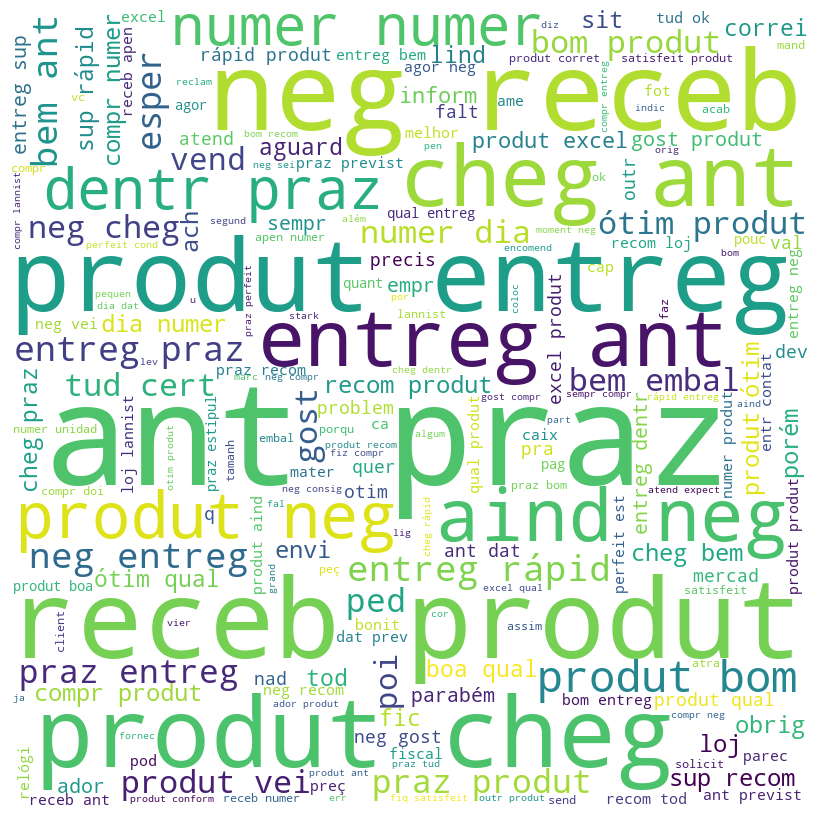

In [118]:
from wordcloud import WordCloud
import matplotlib.pyplot as plt

# Join the stemmed reviews into a single string
stemmed_text = ' '.join(reviews_stemmer)

# Create a WordCloud object
wordcloud = WordCloud(width=800, height=800, background_color='white', min_font_size=10).generate(stemmed_text)

# Display the word cloud using matplotlib
plt.figure(figsize=(8, 8), facecolor=None)
plt.imshow(wordcloud)
plt.axis("off")
plt.tight_layout(pad=0)
plt.show()


In [137]:
data = pd.merge(df_orders, df_customers, on='customer_id') \
           .merge(df_items, on='order_id') \
           .merge(df_reviews, on='order_id') \
           .merge(df_products, on='product_id')



# columns = ['customer_id','customer_unique_id','order_id','product_id', 'order_item_id',
#            'review_score','price', 'order_status','product_category_name']
# data = data[columns].copy()
data.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,review_id,review_score,review_comment_title,review_comment_message,review_creation_date,review_answer_timestamp,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,a54f0611adc9ed256b57ede6b6eb5114,4,NaN,"Não testei o produto ainda, mas ele veio corre...",2017-10-11 00:00:00,2017-10-12 03:43:48,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
1,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28 00:00:00,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-21 20:05:16,29.99,7.78,b46f1e34512b0f4c74a72398b03ca788,4,NaN,Deveriam embalar melhor o produto. A caixa vei...,2017-08-19 00:00:00,2017-08-20 15:16:36,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
2,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15 00:00:00,ef0996a1a279c26e7ecbd737be23d235,2290,sao paulo,SP,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-08 18:37:31,29.99,7.78,dc90f19c2806f1abba9e72ad3c350073,5,NaN,"Só achei ela pequena pra seis xícaras ,mais é ...",2017-08-08 00:00:00,2017-08-08 23:26:23,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
3,bfc39df4f36c3693ff3b63fcbea9e90a,53904ddbea91e1e92b2b3f1d09a7af86,delivered,2017-10-23 23:26:46,2017-10-25 02:14:11,2017-10-27 16:48:46,2017-11-07 18:04:59,2017-11-13 00:00:00,e781fdcc107d13d865fc7698711cc572,88032,florianopolis,SC,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-31 02:14:11,29.99,14.10,1bafb430e498b939f258b9c9dbdff9b1,3,NaN,NaN,2017-11-08 00:00:00,2017-11-10 19:52:38,utilidades_domesticas,40.0,268.0,4.0,500.0,19.0,8.0,13.0
4,53cdb2fc8bc7dce0b6741e2150273451,b0830fb4747a6c6d20dea0b8c802d7ef,delivered,2018-07-24 20:41:37,2018-07-26 03:24:27,2018-07-26 14:31:00,2018-08-07 15:27:45,2018-08-13 00:00:00,af07308b275d755c9edb36a90c618231,47813,barreiras,BA,1,595fac2a385ac33a80bd5114aec74eb8,289cdb325fb7e7f891c38608bf9e0962,2018-07-30 03:24:27,118.70,22.76,8d5266042046a06655c8db133d120ba5,4,Muito boa a loja,Muito bom o produto.,2018-08-08 00:00:00,2018-08-08 18:37:50,perfumaria,29.0,178.0,1.0,400.0,19.0,13.0,19.0


In [139]:
data.describe()

,customer_zip_code_prefix,order_item_id,price,freight_value,review_score,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm
count,112372.000000,112372.000000,112372.000000,112372.000000,112372.000000,110774.000000,110774.000000,110774.000000,112354.000000,112354.000000,112354.000000,112354.000000
mean,35131.880691,1.196010,120.378962,19.977752,4.032473,48.777583,786.793932,2.207124,2090.610882,30.152198,16.576811,23.001210
std,29894.587573,0.691243,182.152386,15.781421,1.387849,10.025179,651.609498,1.719787,3748.608093,16.139323,13.437792,11.707552
min,1003.000000,1.000000,0.850000,0.000000,1.000000,5.000000,4.000000,1.000000,0.000000,7.000000,2.000000,6.000000
25%,11250.000000,1.000000,39.900000,13.070000,4.000000,42.000000,348.000000,1.000000,300.000000,18.000000,8.000000,15.000000
50%,24320.000000,1.000000,74.900000,16.250000,5.000000,52.000000,601.000000,1.000000,700.000000,25.000000,13.000000,20.000000
75%,59063.000000,1.000000,134.900000,21.150000,5.000000,57.000000,985.000000,3.000000,1800.000000,38.000000,20.000000,30.000000
max,99990.000000,21.000000,6735.000000,409.680000,5.000000,76.000000,3992.000000,20.000000,40425.000000,105.000000,105.000000,118.000000


In [140]:
data.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state', 'order_item_id', 'product_id', 'seller_id',
       'shipping_limit_date', 'price', 'freight_value', 'review_id',
       'review_score', 'review_comment_title', 'review_comment_message',
       'review_creation_date', 'review_answer_timestamp',
       'product_category_name', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm'],
      dtype='object')

## MEAN REVIEWS BY PRODUCT

In [141]:
total_reviews = data.groupby('product_id')[['product_id']]\
                  .count()\
                  .rename(columns = {'product_id': 'total_reviews'})\
                  .sort_values(by ="total_reviews", ascending=False)
total_reviews.head(10)

,total_reviews
product_id,
aca2eb7d00ea1a7b8ebd4e68314663af,524
422879e10f46682990de24d770e7f83d,486
99a4788cb24856965c36a24e339b6058,482
389d119b48cf3043d311335e499d9c6b,391
368c6c730842d78016ad823897a372db,388
53759a2ecddad2bb87a079a1f1519f73,373
d1c427060a0f73f6b889a5c7c61f2ac4,340
53b36df67ebb7c41585e8d54d6772e08,320
154e7e31ebfa092203795c972e5804a6,292


In [142]:
mean_reviews = data.groupby('product_id')[['review_score']]\
                    .mean()\
                    .rename(columns = {'review_score': 'avg_review'})\
                    .sort_values(by ="avg_review", ascending=False)
mean_reviews.head(10)

,avg_review
product_id,
00066f42aeeb9f3007548bb9d3f33c38,5.0
60314cbf527af04ebc935be7c02dc1cd,5.0
5fe23e6307c231e287f13c0a4be06c88,5.0
5fe490e61e7a37f2f0d1ad1771ac027d,5.0
c696cd2db7870be08c37822f7c0ef831,5.0
5fef486f2057e10fd91e167348812b7a,5.0
5ff4076c0f01eeba4f728c9e3fa2653c,5.0
5ff59c5f2db7600fa8143442c8b1e4f6,5.0
c68b419d9c6038271b85bac98adb0fc9,5.0


In [143]:
avg_price = data.groupby('product_id')[['price']]\
                 .mean()\
                 .rename(columns = {'price': 'avg_prico'})\
                 .sort_values(by ="avg_prico", ascending=False)
avg_price.head(10)

,avg_prico
product_id,
489ae2aa008f021502940f251d4cce7f,6735.00
1bdf5e6731585cf01aa8169c7028d6ad,6499.00
a6492cc69376c469ab6f61d8f44de961,4799.00
c3ed642d592594bb648ff4a04cee2747,4690.00
259037a6a41845e455183f89c5035f18,4590.00
a1beef8f3992dbd4cd8726796aa69c53,4399.87
6cdf8fc1d741c76586d8b6b15e9eef30,4099.99
6902c1962dd19d540807d0ab8fade5c6,3999.90
4ca7b91a31637bd24fb8e559d5e015e4,3999.00


In [144]:
data_product = data[['product_id']] # New df to keep the agruped columns 
data_product.drop_duplicates(inplace = True)
data_product.set_index("product_id", inplace = True)

data_product['total_reviews'] = total_reviews
data_product['avg_reviews']   = mean_reviews
data_product['avg_price']     = avg_price

data_product.head()

/var/folders/z5/nz2mx8q574d4nnplqvw824hh0000gn/T/ipykernel_20406/356914299.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/z5/nz2mx8q574d4nnplqvw824hh0000gn/T/ipykernel_20406/356914299.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/var/folders/z5/nz2mx8q574d4nnplqvw824hh0000gn/T/ipykernel_20406/356914299.py:6: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/u

,total_reviews,avg_reviews,avg_price
product_id,,,
87285b34884572647811a353c7ac498a,4,4.00000,29.990000
595fac2a385ac33a80bd5114aec74eb8,106,4.40566,119.216038
aa4383b373c6aca5d8797843e5594415,3,5.00000,159.233333
d0b61bfb1de832b15ba9d266ca96e5b0,4,4.25000,42.750000
65266b2da20d04dbe00c5c2d3bb7859e,40,3.72500,21.800000


In [145]:
data_product.shape

(32789, 3)

## DISTRIBUTION OF AVAREGE REVIEWS


/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



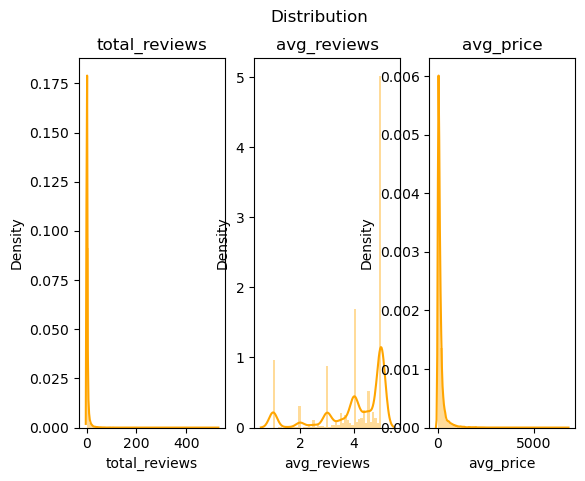

In [146]:
plt.suptitle("Distribution")
for i, feat in enumerate(data_product):
    plt.subplot(1,len(data_product.columns),i+1)
    sns.distplot(data_product[feat], color ='orange')
    plt.title(f"{feat}")

## VOTE LIMIT

In [147]:
min_qt_votos = min(data_product.query("avg_reviews == 5")['total_reviews'])
max_qt_votos = max(data_product.query("avg_reviews == 5")['total_reviews'])

print(f"min vote for products with media equal to 5: {min_qt_votos}")
print(f"max vote for products with media equal to 5: {max_qt_votos}")

min vote for products with media equal to 5: 1
max vote for products with media equal to 5: 15


/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/opt/anaconda3/lib/python3.9/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).



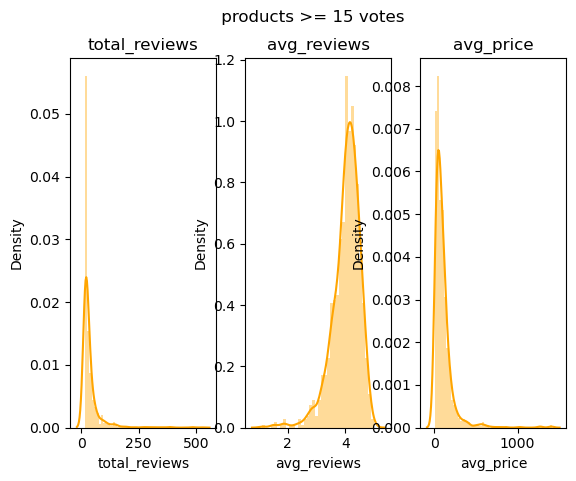

In [148]:
limit_total_review = 15
data_product = data_product[data_product.total_reviews >= limit_total_review ].copy()

plt.suptitle(" products >= 15 votes")
for i, feat in enumerate(data_product):
    plt.subplot(1,len(data_product.columns),i+1)
    sns.distplot(data_product[feat], color = 'orange')
    plt.title(f"{feat}")

In [149]:
data_product.shape

(1082, 3)

In [150]:
import random
from PIL import Image
from datetime import datetime
import unicodedata

import numpy as np
import pandas as pd
import nltk
import matplotlib
from matplotlib import pyplot as plt
import seaborn as sns
from wordcloud import WordCloud

In [151]:
sns.set()

# A color blind safe palette that goes well with the background
COLOR_5S = '#0571b0'
COLOR_1S = '#ca0020'
REVIEWS_PALETTE = sns.color_palette((COLOR_1S, '#d57b6f', '#c6c6c6', '#7f9abc', COLOR_5S))

# Lighter background to help with review categories' colors
sns.set_style('darkgrid', {'axes.facecolor': '#eeeeee'})

# Default figure size
resize_plot = lambda: plt.gcf().set_size_inches(12, 5)

In [153]:
df_reviews['review_creation_date'] = pd.to_datetime(df_reviews['review_creation_date'], format='%Y/%m/%d %H:%M:%S')
df_reviews['review_answer_timestamp'] = pd.to_datetime(df_reviews['review_answer_timestamp'], format='%Y/%m/%d %H:%M:%S')
df_orders['order_purchase_timestamp'] = pd.to_datetime(df_orders['order_purchase_timestamp'], format='%Y/%m/%d %H:%M:%S')
df_orders['order_delivered_customer_date'] = pd.to_datetime(df_orders['order_delivered_customer_date'], format='%Y/%m/%d %H:%M:%S')

# Merge with orders
df_reviews = pd.merge(df_reviews, df_orders, on='order_id')

# Remove unused columns
to_drop = [
    'review_id', 
    'order_id', 
    'customer_id', 
    'review_comment_title', 
    'order_approved_at', 
    'order_delivered_carrier_date', 
    'order_estimated_delivery_date'
]
df_reviews.drop(columns=to_drop, inplace=True)
df_reviews

,review_score,review_comment_message,review_creation_date,review_answer_timestamp,order_status,order_purchase_timestamp,order_delivered_customer_date
0,4,NaN,2018-01-18,2018-01-18 21:46:59,delivered,2018-01-11 15:30:49,2018-01-17 18:42:41
1,5,NaN,2018-03-10,2018-03-11 03:05:13,delivered,2018-02-28 12:25:19,2018-03-09 23:17:20
2,5,NaN,2018-02-17,2018-02-18 14:36:24,delivered,2018-02-03 09:56:22,2018-02-16 17:28:48
3,5,Recebi bem antes do prazo estipulado.,2017-04-21,2017-04-21 22:02:06,delivered,2017-04-09 17:41:13,2017-04-20 09:08:35
4,5,Parabéns lojas lannister adorei comprar pela I...,2018-03-01,2018-03-02 10:26:53,delivered,2018-02-10 10:59:03,2018-02-28 16:33:35
...,...,...,...,...,...,...,...
99219,5,NaN,2018-07-07,2018-07-14 17:18:30,delivered,2018-06-27 17:31:29,2018-07-06 13:22:37
99220,5,NaN,2017-12-09,2017-12-11 20:06:42,delivered,2017-12-03 21:45:23,2017-12-08 17:19:00
99221,5,"Excelente mochila, entrega super rápida. Super...",2018-03-22,2018-03-23 09:10:43,delivered,2018-03-18 09:52:19,2018-03-21 17:44:08
99222,4,NaN,2018-07-01,2018-07-02 12:59:13,delivered,2018-06-22 16:47:28,2018-06-30 12:57:51


In [154]:
df_reviews.head()

,review_score,review_comment_message,review_creation_date,review_answer_timestamp,order_status,order_purchase_timestamp,order_delivered_customer_date
0,4,NaN,2018-01-18,2018-01-18 21:46:59,delivered,2018-01-11 15:30:49,2018-01-17 18:42:41
1,5,NaN,2018-03-10,2018-03-11 03:05:13,delivered,2018-02-28 12:25:19,2018-03-09 23:17:20
2,5,NaN,2018-02-17,2018-02-18 14:36:24,delivered,2018-02-03 09:56:22,2018-02-16 17:28:48
3,5,Recebi bem antes do prazo estipulado.,2017-04-21,2017-04-21 22:02:06,delivered,2017-04-09 17:41:13,2017-04-20 09:08:35
4,5,Parabéns lojas lannister adorei comprar pela I...,2018-03-01,2018-03-02 10:26:53,delivered,2018-02-10 10:59:03,2018-02-28 16:33:35


In [155]:
p_5s = len(df_reviews[df_reviews['review_score'] == 5]) * 100 / len(df_reviews)
p_1s = len(df_reviews[df_reviews['review_score'] == 1]) * 100 / len(df_reviews)
first_dt = df_reviews['review_creation_date'].min()
last_dt = df_reviews['review_creation_date'].max()
avg_s = df_reviews['review_score'].mean()
print(len(df_reviews), 'reviews')
print('First:', first_dt)
print('Last:', last_dt)
print(f'5★: {p_5s:.1f}%')
print(f'1★: {p_1s:.1f}%')
print(f'Average: {avg_s:.1f}★')

99224 reviews
First: 2016-10-02 00:00:00
Last: 2018-08-31 00:00:00
5★: 57.8%
1★: 11.5%
Average: 4.1★


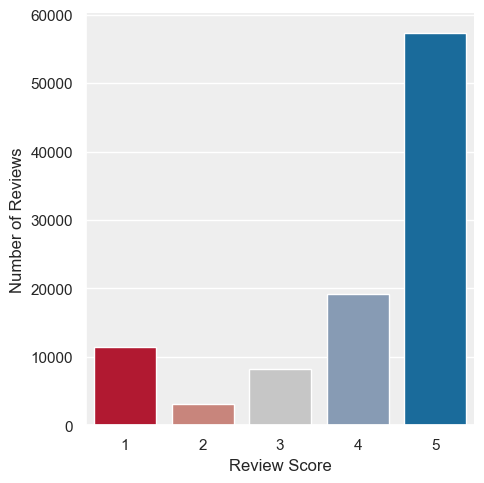

In [156]:
 sns.catplot(
    x='review_score', 
    kind='count', 
    data= df_reviews, 
    palette=REVIEWS_PALETTE
).set(
    xlabel='Review Score', 
    ylabel='Number of Reviews',
);

## Review Creation

In [ ]:
#Our expectation is that customers will create reviews after their corresponding purchases. 
#However, our dataset contains negative values for the review creation delay, 
#indicating that some reviews were sent to customers before their purchase. 
#However, the majority of these reviews were created a few days after the purchase date, as expected.

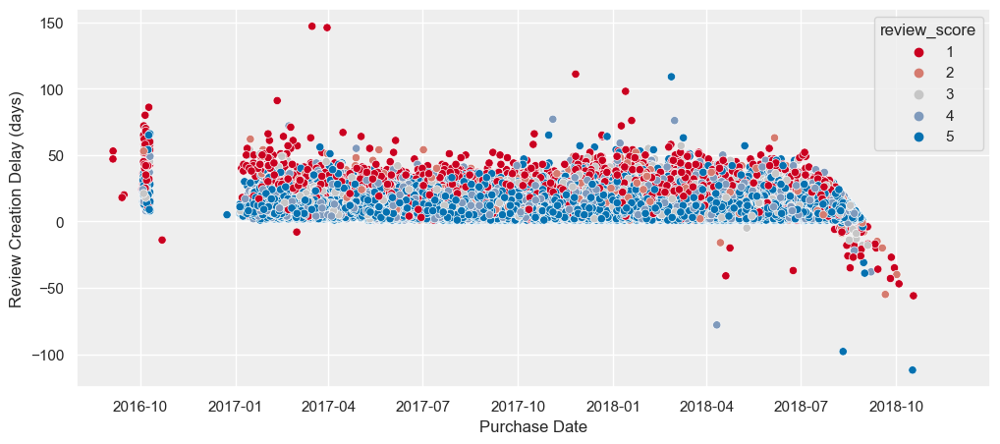

In [157]:
df_reviews['review_creation_delay'] = (df_reviews['review_creation_date'] - df_reviews['order_purchase_timestamp']).dt.days
sns.scatterplot(
    x='order_purchase_timestamp', 
    y='review_creation_delay', 
    hue='review_score', 
    palette= REVIEWS_PALETTE, 
    data=df_reviews
).set(
    xlabel='Purchase Date', 
    ylabel='Review Creation Delay (days)',
    xlim=(datetime(2016, 8, 1), datetime(2018, 12, 31))
);
resize_plot()

In [ ]:
#We group reviews by month using the order_purchase_timestamp column and create a time series plot. 
#To prevent any misleading patterns on our graph, 
#we limit our analysis to reviews that were created after the corresponding purchase date.

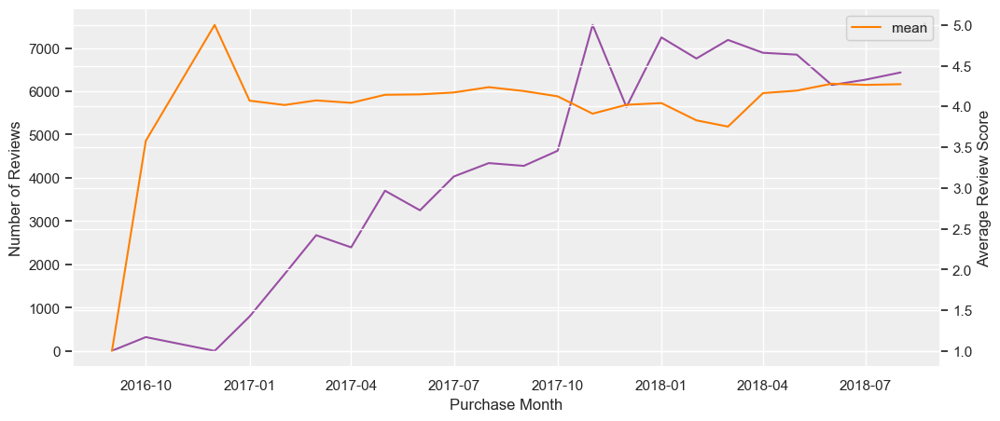

In [158]:
df_reviews['year_month'] = df_reviews['order_purchase_timestamp'].dt.to_period('M')
reviews_timeseries = df_reviews[df_reviews['review_creation_delay'] > 0].groupby('year_month')['review_score'].agg(['count', 'mean'])

ax = sns.lineplot(
    x=reviews_timeseries.index.to_timestamp(), 
    y='count', 
    data=reviews_timeseries, 
    color='#984ea3', 
    label='count'
)
ax.set(xlabel='Purchase Month', ylabel='Number of Reviews')

sns.lineplot(
    x=reviews_timeseries.index.to_timestamp(),
    y='mean',
    data=reviews_timeseries, 
    ax=ax.twinx(), 
    color='#ff7f00', 
    label='mean'
).set(ylabel='Average Review Score');
resize_plot()

In [159]:
df_reviews.groupby('order_status')['order_status'].count()

order_status
approved           2
canceled         609
created            3
delivered      96361
invoiced         313
processing       296
shipped         1043
unavailable      597
Name: order_status, dtype: int64

## Exploring Reviews by Verifying Their Order Status

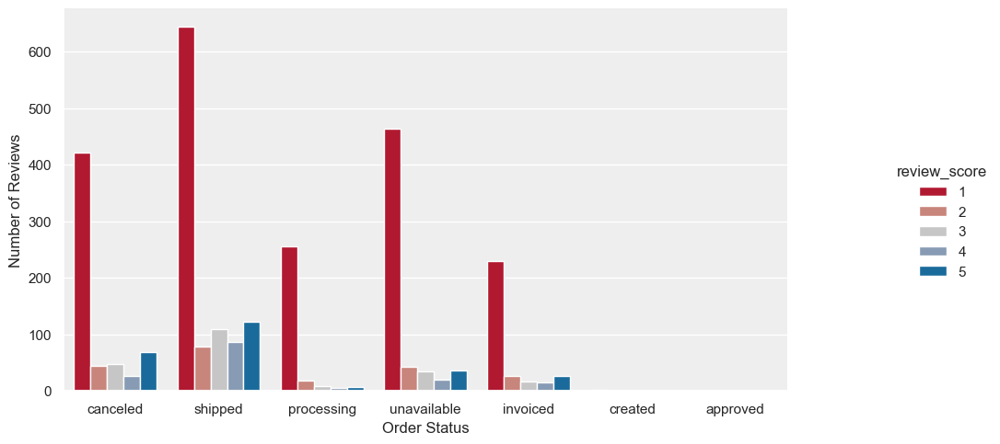

In [161]:
ax = sns.catplot(
    x='order_status',
    kind='count',
    hue='review_score',
    data=df_reviews[df_reviews['order_status'] != 'delivered'],
    palette=REVIEWS_PALETTE
).set(xlabel='Order Status', ylabel='Number of Reviews');
resize_plot()

In [ ]:
#To determine how long customers take to respond to Olist's satisfaction survey, 
#we can compare the values in the review_answer_timestamp and review_creation_date columns.

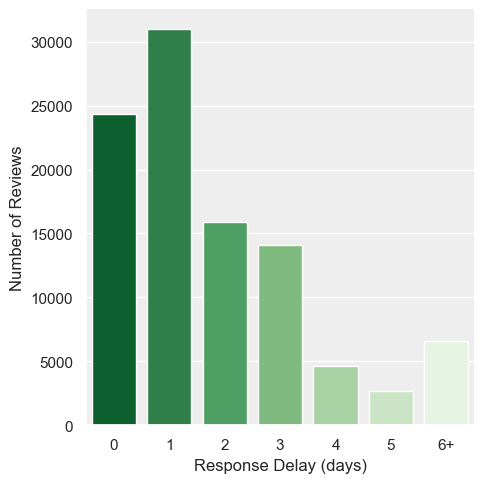

In [163]:
df_reviews['delay'] = (df_reviews['review_answer_timestamp'] - df_reviews['review_creation_date']).dt.days

bins = [-1, 0, 1, 2, 3, 4, 5, 99999]
labels = ['0', '1', '2', '3', '4', '5', '6+']
df_reviews['delay_group'] = pd.cut(df_reviews['delay'], bins, labels=labels)

sns.catplot(
    x='delay_group', 
    kind='count', 
    data=df_reviews, 
    palette=sns.color_palette('Greens_r', n_colors=7)
).set(xlabel='Response Delay (days)', ylabel='Number of Reviews');

In [ ]:
#It is evident that although the majority of customers take a day to respond, 
#dissatisfied customers who leave 1-star reviews are more inclined to respond on the same day.

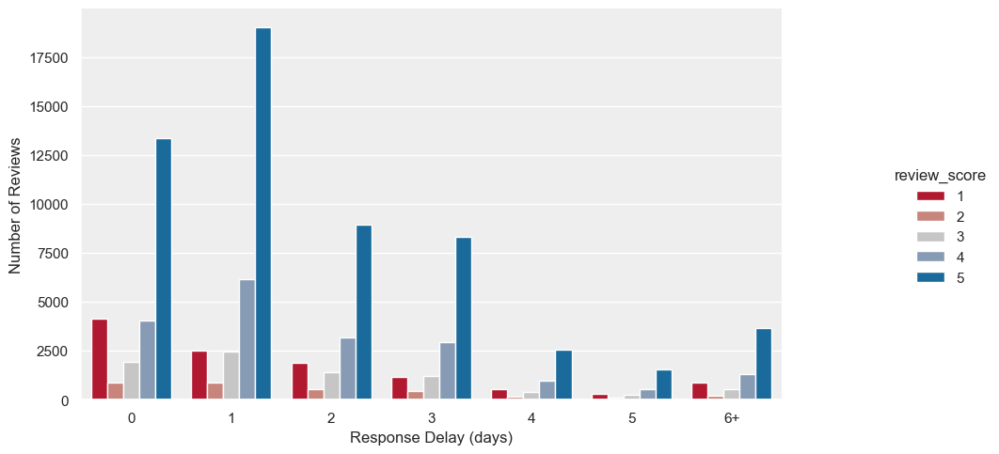

In [164]:
sns.catplot(
    x='delay_group', 
    kind='count', 
    hue='review_score', 
    data= df_reviews, 
    palette=REVIEWS_PALETTE
).set(xlabel='Response Delay (days)', ylabel='Number of Reviews');
resize_plot()

## Exploring Review Comments

In [ ]:
#Despite analyzing review ratings, our understanding of the specific aspects of Olist's experience that customers either like or dislike remains limited. 
#To gain further insight, we will begin by calculating the length of the review_comment_message.

In [165]:
df_reviews['review_length'] = df_reviews['review_comment_message'].str.len()
df_reviews[['review_score', 'review_length', 'review_comment_message']].head()

,review_score,review_length,review_comment_message
0,4,NaN,NaN
1,5,NaN,NaN
2,5,NaN,NaN
3,5,37.0,Recebi bem antes do prazo estipulado.
4,5,100.0,Parabéns lojas lannister adorei comprar pela I...


In [4]:
#The comment rate can be calculated by dividing the total number of non-NaN comments by the total number of reviews.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/_decorators.py:36: FutureWarning:

Pass the following variables as keyword args: x, y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.



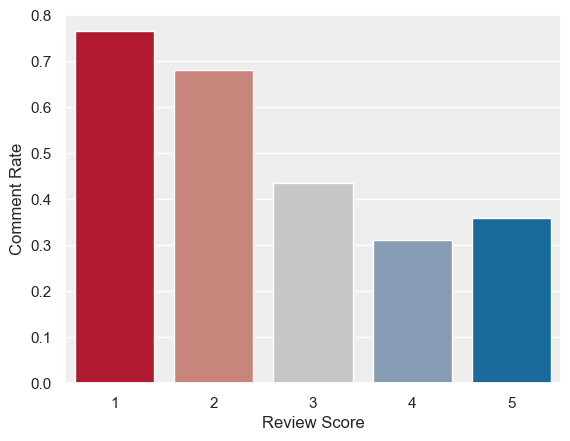

In [166]:
def comment_rate(df):
    return df['review_length'].count() / len(df)

comment_rates = df_reviews.groupby('review_score').apply(comment_rate)
sns.barplot(
    comment_rates.index, 
    comment_rates.values, 
    palette=REVIEWS_PALETTE
).set(xlabel='Review Score', ylabel='Comment Rate');

In [3]:
#The observation is that dissatisfied customers are more likely to leave longer comments compared to satisfied customers.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:703: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:703: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:703: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:703: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.

/opt/anaconda3/lib/python3.9/site-packages/seaborn/axisgrid.py:703: FutureWarning:

iteritems is deprecated and will be removed in a future version. Use .items instead.



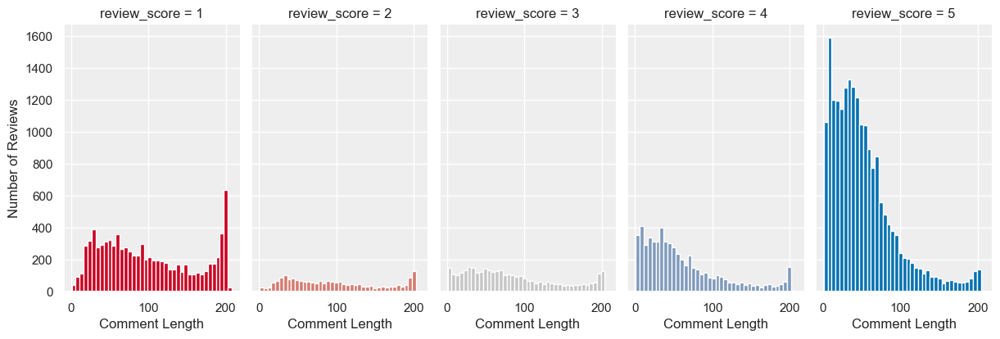

In [167]:
g = sns.FacetGrid(data= df_reviews, col='review_score', hue='review_score', palette=REVIEWS_PALETTE)
g.map(plt.hist, 'review_length', bins=40)
g.set_xlabels('Comment Length')
g.set_ylabels('Number of Reviews')
plt.gcf().set_size_inches(12, 5)

In [ ]:
#The purpose of the text is to outline a process for discovering the content of comments left by customers using Natural Language Processing. The process is summarized as follows:

#1. Convert the text to lowercase to standardize the text and remove case sensitivity.
#2. Use compatibility decomposition to decompose accented characters like ã into a~ to standardize the text.
#3. Encode the text to ASCII, ignoring errors, to remove any remaining non-ASCII characters like accents.
#4. Re-encode the text to utf8 to restore any lost characters during the ASCII encoding.
#5. Tokenize the text by breaking it down into individual words.
#6. Remove stop words like "and," "the," "a," etc., and non-alpha strings such as special characters and numbers to focus on the content words.

In [168]:
def remove_accents(text):
    return unicodedata.normalize('NFKD', text).encode('ascii', errors='ignore').decode('utf-8')

STOP_WORDS = set(remove_accents(w) for w in nltk.corpus.stopwords.words('portuguese'))
STOP_WORDS.remove('nao') # This word is key to understand delivery problems later


def comments_to_words(comment):
    lowered = comment.lower()
    normalized = remove_accents(lowered)
    tokens = nltk.tokenize.word_tokenize(normalized)
    words = tuple(t for t in tokens if t not in STOP_WORDS and t.isalpha())
    return words

def words_to_ngrams(words):
    unigrams, bigrams, trigrams = [], [], []
    for comment_words in words:
        unigrams.extend(comment_words)
        bigrams.extend(' '.join(bigram) for bigram in nltk.bigrams(comment_words))
        trigrams.extend(' '.join(trigram) for trigram in nltk.trigrams(comment_words))
    
    return unigrams, bigrams, trigrams

def plot_freq(tokens, color):
    resize_plot()
    nltk.FreqDist(tokens).plot(25, cumulative=False, color=color)

In [169]:
commented_reviews = df_reviews[df_reviews['review_comment_message'].notnull()].copy()
commented_reviews['review_comment_words'] = commented_reviews['review_comment_message'].apply(comments_to_words)

reviews_5s = commented_reviews[commented_reviews['review_score'] == 5]
reviews_1s = commented_reviews[commented_reviews['review_score'] == 1]

unigrams_5s, bigrams_5s, trigrams_5s = words_to_ngrams(reviews_5s['review_comment_words'])
unigrams_1s, bigrams_1s, trigrams_1s = words_to_ngrams(reviews_1s['review_comment_words'])

In [ ]:
#The frequency distributions provided below depicts the occurrence of 5-star n-grams that highlight specific topics which Olist's customers have expressed their satisfaction with. 
#These include fast delivery, indicated by n-grams such as "chegou antes prazo", "entrega rapida", 
#"entregue antes prazo", and "super rapida"; high-quality goods, 
#as evidenced by n-grams such as "produto otima qualidade", "otimo produto", "produto excelente", 
#and "produto boa qualidade"; and good packaging, demonstrated by n-grams such as "bem embalado" and "produto chegou bem".

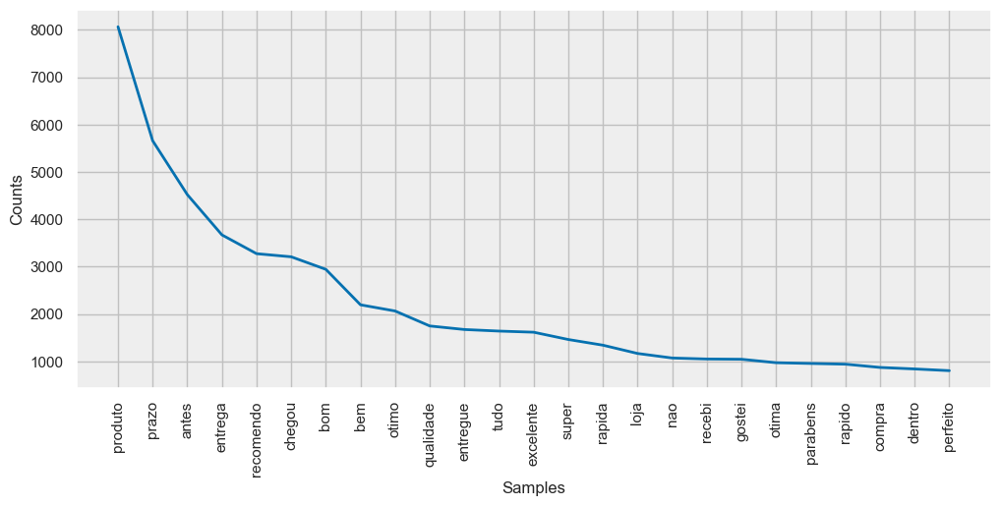

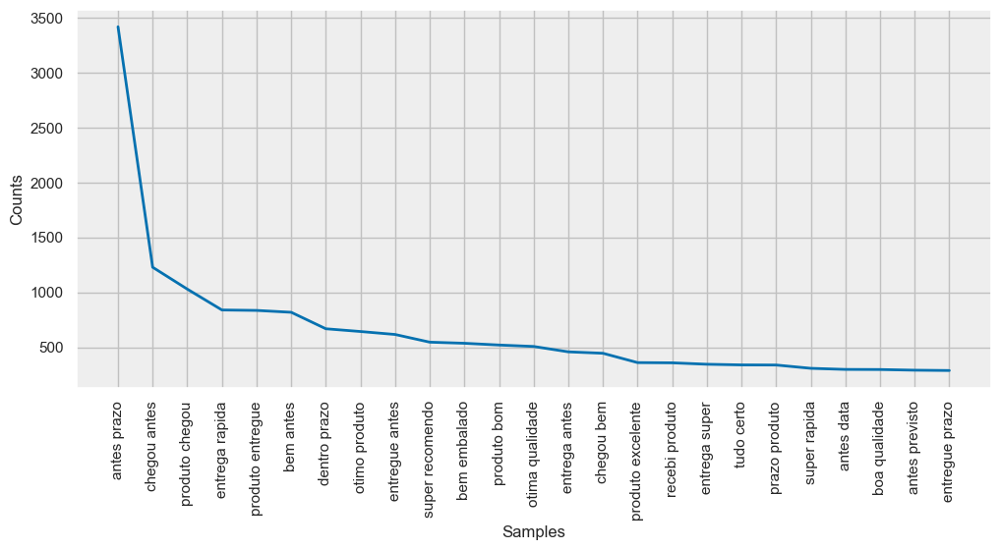

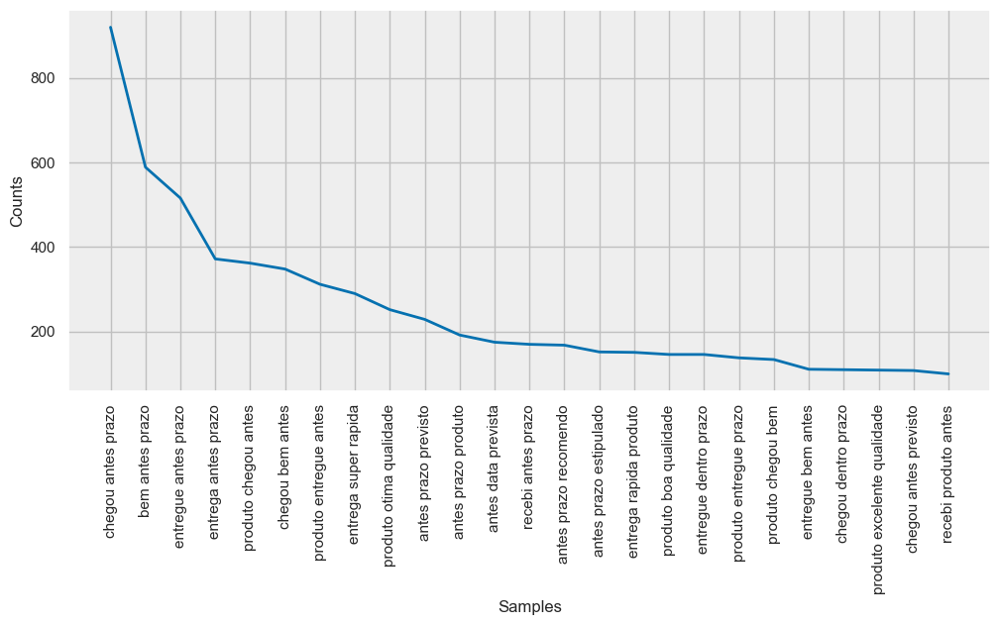

In [170]:

plot_freq(unigrams_5s, COLOR_5S)
plot_freq(bigrams_5s, COLOR_5S)
plot_freq(trigrams_5s, COLOR_5S)

In [2]:
#The frequency distributions presented below show the occurrence of 1-star n-grams that highlight specific topics which Olist's customers have expressed their dissatisfaction with. 
#These include the non-delivery of their goods, problems related to their invoices, the desire for a refund, the poor quality of the goods received, 
#issues with purchasing multiple products, negative experiences with the Lannister's shop, and possibly poor customer service. 
#Although selecting reviews created after the product's delivery helps to filter out some comments about delivery, there are still some that persist. 
#Additionally, new topics related to incorrect product delivery and counterfeit goods have emerged, 
#as evidenced by n-grams such as "recebi produto errado", "produto veio errado", "produto totalmente diferente", and "produto não original".

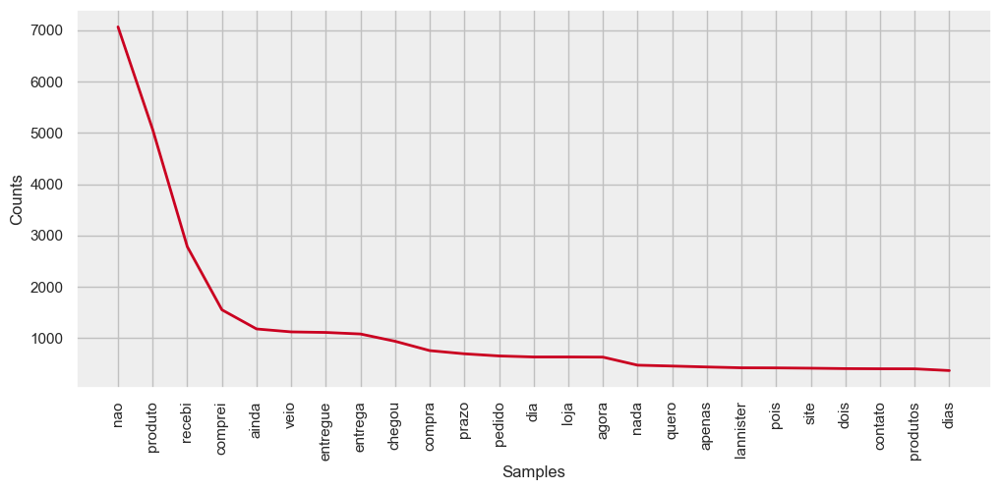

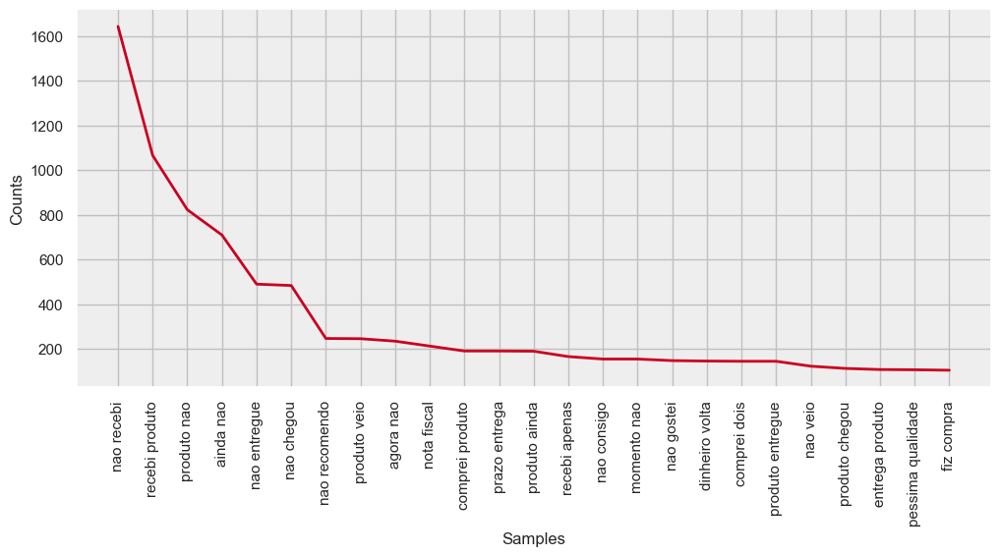

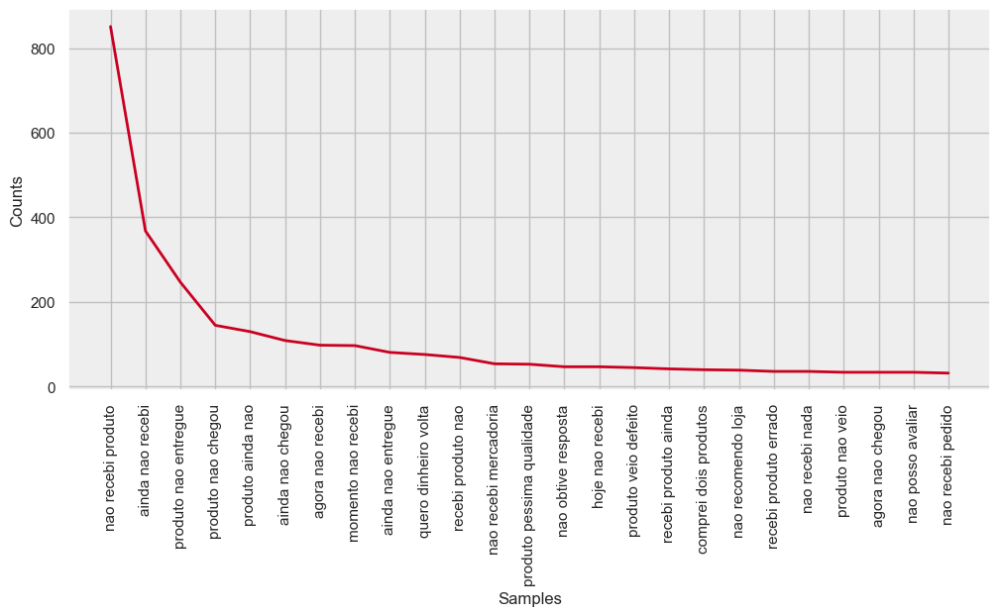

In [171]:
plot_freq(unigrams_1s, COLOR_1S)
plot_freq(bigrams_1s, COLOR_1S)
plot_freq(trigrams_1s, COLOR_1S)

## WORD CLOUD

In [1]:
#Olist's customers love the fast shipping their partners provide, but there's still room for improvement. 
#Here are word clouds representing 5 and 1 star reviews.

In [174]:
import nltk

# Download required data for tokenization
nltk.download('punkt')
nltk.download('stopwords')

[nltk_data] Downloading package punkt to /Users/aa/nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package stopwords to /Users/aa/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


True

In [175]:
def search_words(df, words, n_samples=5, context_character_count=30):
    print(f'Search for "{words.upper()}"')
    words_set = set(words.split(' '))
    
    # Initial filter
    df = commented_reviews[commented_reviews['review_comment_words'].map(set) & words_set]
    
    if not len(df):
        print('> Number of reviews: 0\n')
        return

    # Filter by ordered words
    ordered_words_filter = lambda row, words: words in ' '.join(row['review_comment_words'])
    df = df[df.apply(ordered_words_filter, axis=1, args=(words,))]
    
    if len(df):
        print('> Number of reviews:', len(df))
    else:
        print('> Number of reviews: 0\n')
        return
    
    avg_rating = df['review_score'].mean()
    print(f'> Average rating: {avg_rating:.1f}★')
    
    if n_samples:
        print('> Samples:')
        first_word = words.split(' ')[0]
        for _, row in df.head(n_samples).iterrows():
            comment = row['review_comment_message'].replace('\r', '').replace('\n', '')
            score = row['review_score']
            normalized_comment = remove_accents(comment.lower())
            first_word_index = normalized_comment.index(first_word)

            i1 = first_word_index - context_character_count
            i2 = first_word_index + len(words) + context_character_count
            e1, e2 = '… ', ' …'

            if i1 < 0:
                i1 = 0
                e1 = ''

            if i2 > len(comment):
                i2 = len(comment)
                e2 = ''

            print(f'  {score}★', e1 + comment[i1:i2] + e2)
    print()

In [181]:
GOT_HOUSES = [
    'baratheon',
    'lannister',
    'stark',
    'targaryen',
]

for house in GOT_HOUSES:
    search_words(commented_reviews, house)

Search for "BARATHEON"
> Number of reviews: 273
> Average rating: 3.7★
> Samples:
  5★ … que isso me faria desistir do baratheon.
  1★ … ndimento e NUNCA mais compro. baratheon quando vendia por eles mesmos …
  5★ Tudo ok,o baratheon sempre responsável com a suas …
  5★ … os, já faz anos que compro no baratheon !!
  5★ Eu compro sempre no baratheon e adoro tudo.

Search for "LANNISTER"
> Number of reviews: 1067
> Average rating: 3.1★
> Samples:
  5★ Parabéns lojas lannister adorei comprar pela Internet  …
  3★ … do solução por parte de Lojas lannister.
  3★ … ês após a compra. No site das lannister costumam chegar antes do praz …
  3★ … E. Quando tentei reclamar nas lannister o sistema estaav fora do ar.  …
  1★ … tes da entrega, liguei para a lannister e os atendentes não sabiam o  …

Search for "STARK"
> Number of reviews: 299
> Average rating: 3.1★
> Samples:
  1★ … redito ser o prazo máximo. No stark o prazo máximo já se esgotou  …
  5★ sempre comprei no stark e estou satisfeito.
 

In [198]:
def rgb_float_to_int(rgb):
    return tuple(int(255 * c) for c in rgb)

WORDCLOUD_1S_PALETTE = [rgb_float_to_int(rgb) for rgb in sns.color_palette('Reds', n_colors=9)[2:]]
WORDCLOUD_5S_PALETTE = [rgb_float_to_int(rgb) for rgb in sns.color_palette('Blues', n_colors=9)[2:]]

def get_1s_color(*args, **kwargs):
    return random.choice(WORDCLOUD_1S_PALETTE)

def get_5s_color(*args, **kwargs):
    return random.choice(WORDCLOUD_5S_PALETTE)

def plot_wordcloud(words, style):
    if style == '1s':
        color_function = get_1s_color
        mask_fn = '/Users/aa/Desktop/Thumbsdown.png'
        
    elif style == '5s':
        color_function = get_5s_color
        mask_fn = 'thumbs_up.png'
        
    mask = np.array(Image.open('/Users/aa/Desktop/Thumbsdown.png'))[:, :]
    mask_icon = mask == 0
    mask_bg = mask > 0
    mask[mask_icon] = 255
    mask[mask_bg] = 0
        
    wordcloud = WordCloud(background_color='white', mask=mask)
    wordcloud.generate(' '.join(words))
    wordcloud.recolor(color_func=color_function)
    
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.gcf().set_size_inches(16, 10)

In [201]:
def plot_wordcloud(words, style):
    if style == '1s':
        color_function = get_1s_color
        mask_fn = '/Users/aa/Desktop/thumbsdown.png'
        
    elif style == '5s':
        color_function = get_5s_color
        mask_fn = '/Users/aa/Desktop/Thumbsup.png'
        
    mask = np.array(Image.open(mask_fn))[:, :]
    mask_icon = mask == 0
    mask_bg = mask > 0
    mask[mask_icon] = 255
    mask[mask_bg] = 0
        
    wordcloud = WordCloud(background_color='white', mask=mask)
    wordcloud.generate(' '.join(words))
    wordcloud.recolor(color_func=color_function)
    
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.gcf().set_size_inches(16, 10)


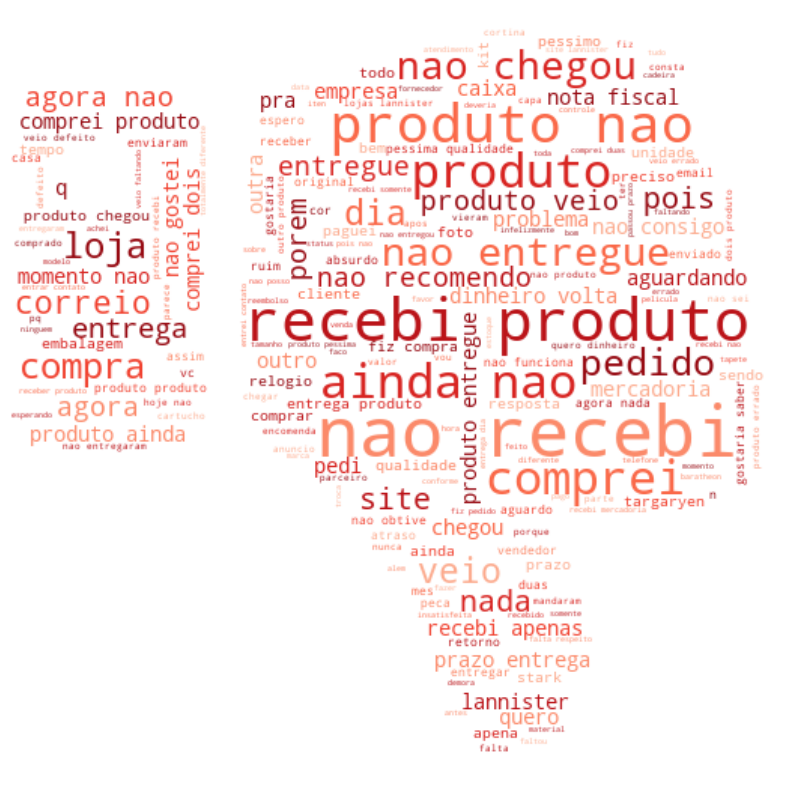

In [202]:
plot_wordcloud(unigrams_1s, '1s')


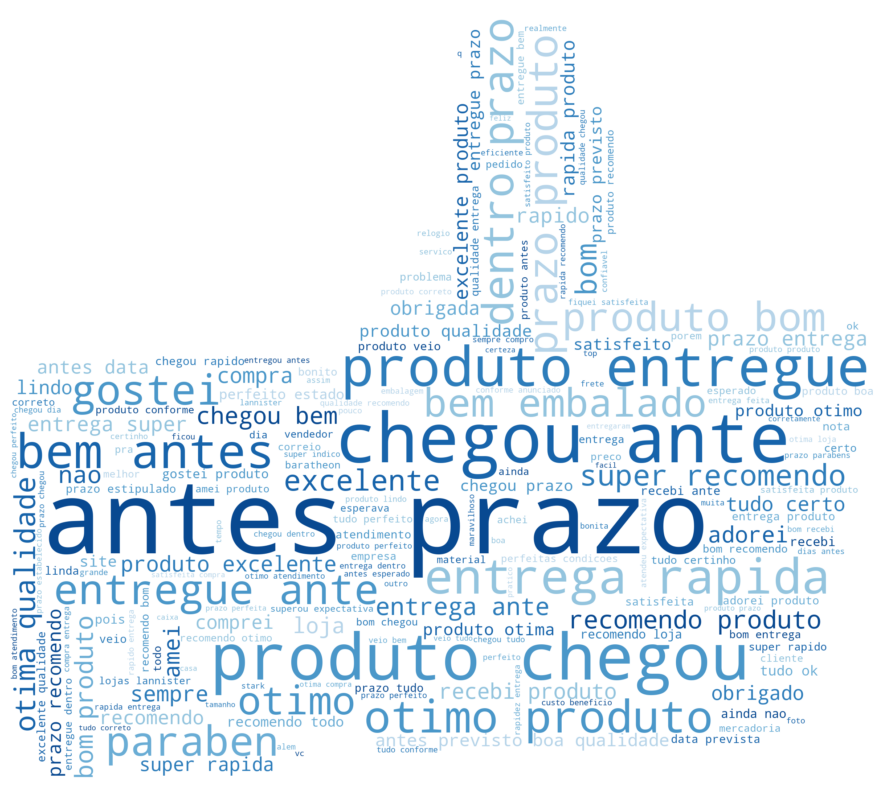

In [203]:
plot_wordcloud(unigrams_5s, '5s')

# Predicting Delivery Times

One issue that customers frequently reported on negative reviews of Olist was that their orders did not arrive at the time that Olist estimated they would. These reviews made our group believe that unreliable delivery times could be a contributing factor to low customer retention rates. Consequently, we tried to create a model that would better predict delivery times for Olist. 

In [72]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
pd.options.display.max_columns = None

## Loading the Data

The data comes from a Kaggle dataset on a Brazilian e-commerce company: https://www.kaggle.com/datasets/olistbr/brazilian-ecommerce

In [73]:
df_customers = pd.read_csv('Final_Project_Data/olist_customers_dataset.csv') 
df_geolocation = pd.read_csv('Final_Project_Data/olist_geolocation_dataset.csv') 
df_order_items = pd.read_csv('Final_Project_Data/olist_order_items_dataset.csv') 
df_order_payments = pd.read_csv('Final_Project_Data/olist_order_payments_dataset.csv') 
df_order_reviews = pd.read_csv('Final_Project_Data/olist_order_reviews_dataset.csv') 
df_orders = pd.read_csv('Final_Project_Data/olist_orders_dataset.csv', parse_dates=['order_purchase_timestamp','order_delivered_customer_date','order_estimated_delivery_date']) 
df_products = pd.read_csv('Final_Project_Data/olist_products_dataset.csv') 
df_sellers = pd.read_csv('Final_Project_Data/olist_sellers_dataset.csv') 
df_product_catname_translation = pd.read_csv('Final_Project_Data/product_category_name_translation.csv') 

### Merging the Dataframes

The data was split into several dataframes based on topic. There is a dataframe for order information, for customer information, for seller information, etc. Consequently, several dataframes had to be combined to get all the information needed for the analysis. 

In [75]:
df_orders = df_orders.merge(df_order_items, on='order_id')

In [77]:
df_orders = df_orders.merge(df_products, on='product_id')
product_map = df_product_catname_translation.set_index('product_category_name')['product_category_name_english']
product_map = product_map.to_dict()
df_orders.product_category_name = df_orders.product_category_name.map(product_map)

In [78]:
df_orders = df_orders.merge(df_customers, on='customer_id')


In [79]:
df_orders = df_orders.merge(df_sellers, on='seller_id')

## Feature Creation and Selection 

First, we want to limit the data to only orders that were completed, as we will not be able to train our data on orders that are cancelled or still processing. 

In [80]:
df_orders.order_status.value_counts()

delivered      110197
shipped          1185
canceled          542
invoiced          359
processing        357
unavailable         7
approved            3
Name: order_status, dtype: int64

In [81]:
delivered_items = df_orders[df_orders.order_status == 'delivered']

In [82]:
delivered_items.shape

(110197, 29)

Next, we will select the columns we will use to make the predictions. In particular, we will select columns with information about the seller location, customer location, product dimensions, and product contents. 

In [83]:
delivered_items.head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,seller_id,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,seller_zip_code_prefix,seller_city,seller_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-06 11:07:15,29.99,8.72,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP,9350,maua,SP
1,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-21 20:05:16,29.99,7.78,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP,9350,maua,SP
2,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-08 18:37:31,29.99,7.78,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,ef0996a1a279c26e7ecbd737be23d235,2290,sao paulo,SP,9350,maua,SP
3,bfc39df4f36c3693ff3b63fcbea9e90a,53904ddbea91e1e92b2b3f1d09a7af86,delivered,2017-10-23 23:26:46,2017-10-25 02:14:11,2017-10-27 16:48:46,2017-11-07 18:04:59,2017-11-13,1,87285b34884572647811a353c7ac498a,3504c0cb71d7fa48d967e0e4c94d59d9,2017-10-31 02:14:11,29.99,14.10,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,e781fdcc107d13d865fc7698711cc572,88032,florianopolis,SC,9350,maua,SP
4,8736140c61ea584cb4250074756d8f3b,ab8844663ae049fda8baf15fc928f47f,delivered,2017-08-10 13:35:55,2017-08-10 13:50:09,2017-08-11 13:52:35,2017-08-16 19:03:36,2017-08-23,1,b00a32a0b42fd65efb58a5822009f629,3504c0cb71d7fa48d967e0e4c94d59d9,2017-08-16 13:50:09,75.90,7.79,baby,58.0,398.0,3.0,238.0,20.0,10.0,15.0,02c9e0c05a817d4562ec0e8c90f29dba,8577,itaquaquecetuba,SP,9350,maua,SP


In [84]:
delivered_items = delivered_items[['order_purchase_timestamp',
        'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'shipping_limit_date',
       'price', 'freight_value', 'product_category_name',
       'product_name_lenght', 'product_description_lenght',
       'product_photos_qty', 'product_weight_g', 'product_length_cm',
       'product_height_cm', 'product_width_cm',
       'customer_zip_code_prefix', 'customer_city', 'customer_state',
       'seller_zip_code_prefix', 'seller_city', 'seller_state']]

In [85]:
delivered_items.head()

,order_purchase_timestamp,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,shipping_limit_date,price,freight_value,product_category_name,product_name_lenght,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_zip_code_prefix,customer_city,customer_state,seller_zip_code_prefix,seller_city,seller_state
0,2017-10-02 10:56:33,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18,2017-10-06 11:07:15,29.99,8.72,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,3149,sao paulo,SP,9350,maua,SP
1,2017-08-15 18:29:31,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28,2017-08-21 20:05:16,29.99,7.78,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,3366,sao paulo,SP,9350,maua,SP
2,2017-08-02 18:24:47,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15,2017-08-08 18:37:31,29.99,7.78,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,2290,sao paulo,SP,9350,maua,SP
3,2017-10-23 23:26:46,2017-10-27 16:48:46,2017-11-07 18:04:59,2017-11-13,2017-10-31 02:14:11,29.99,14.10,housewares,40.0,268.0,4.0,500.0,19.0,8.0,13.0,88032,florianopolis,SC,9350,maua,SP
4,2017-08-10 13:35:55,2017-08-11 13:52:35,2017-08-16 19:03:36,2017-08-23,2017-08-16 13:50:09,75.90,7.79,baby,58.0,398.0,3.0,238.0,20.0,10.0,15.0,8577,itaquaquecetuba,SP,9350,maua,SP


In [86]:
delivered_items.customer_city.value_counts()

sao paulo               17400
rio de janeiro           7592
belo horizonte           3087
brasilia                 2341
curitiba                 1727
                        ...  
rio grande do piaui         1
desterro do melo            1
antonio goncalves           1
ribeirao cascalheira        1
canto do buriti             1
Name: customer_city, Length: 4085, dtype: int64

### Measuring distance between cities

One particularly important feature for our predictions would be distance between the customer and the seller. This information is not explicitly listed. However, we do know the city of the seller and the city of the buyer. We can find the approximate distance by getting the latitude and longitude of both cities, and then measuring the distance between them. 

In [87]:
city_locations = df_geolocation.groupby('geolocation_city')['geolocation_city','geolocation_lat','geolocation_lng'].first()
city_locations.reset_index(drop=True,inplace=True)

/tmp/ipykernel_338483/940603109.py:1: FutureWarning: Indexing with multiple keys (implicitly converted to a tuple of keys) will be deprecated, use a list instead.
  city_locations = df_geolocation.groupby('geolocation_city')['geolocation_city','geolocation_lat','geolocation_lng'].first()


In [88]:
delivered_items = delivered_items.merge(city_locations, left_on='customer_city', right_on='geolocation_city', how='left')
delivered_items.rename({'geolocation_lat': 'customer_lat', 'geolocation_lng': 'customer_long'},axis=1, inplace=True)
delivered_items = delivered_items.merge(city_locations, left_on='seller_city', right_on='geolocation_city', how='left')
delivered_items.rename({'geolocation_lat': 'seller_lat', 'geolocation_lng': 'seller_long'},axis=1, inplace=True)

In [89]:
import math

def calculate_distance(lat1, lon1, lat2, lon2):
    R = 6371  # radius of the earth in kilometers
    dlat = math.radians(lat2 - lat1)
    dlon = math.radians(lon2 - lon1)
    a = math.sin(dlat / 2) * math.sin(dlat / 2) + math.cos(math.radians(lat1)) \
        * math.cos(math.radians(lat2)) * math.sin(dlon / 2) * math.sin(dlon / 2)
    c = 2 * math.atan2(math.sqrt(a), math.sqrt(1 - a))
    distance = R * c
    return distance

# apply the distance calculation function to the dataframe
delivered_items['distance'] = delivered_items.apply(lambda row: calculate_distance(row['customer_lat'], row['customer_long'], row['seller_lat'], row['seller_long']), axis=1)



In [90]:
delivered_items = delivered_items[['order_purchase_timestamp',
       'order_delivered_customer_date', 'order_estimated_delivery_date', 'price', 'freight_value',
       'product_category_name', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
        'customer_city', 'customer_state',
        'seller_city', 'seller_state','distance']]

In [91]:
delivered_items.tail(10)

,order_purchase_timestamp,order_delivered_customer_date,order_estimated_delivery_date,price,freight_value,product_category_name,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_city,customer_state,seller_city,seller_state,distance
110187,2018-07-25 16:18:46,2018-07-30 19:42:42,2018-08-13,89.90,18.73,furniture_decor,450.0,16.0,16.0,16.0,araxa,MG,marilia,SP,425.698898
110188,2017-07-24 11:29:43,2017-08-10 19:42:10,2017-08-23,29.40,17.92,auto,700.0,16.0,7.0,11.0,vitoria da conquista,BA,sao paulo,SP,1140.413178
110189,2017-11-20 12:49:35,2017-12-27 00:06:56,2017-12-18,59.90,19.66,NaN,1500.0,30.0,10.0,36.0,campo verde,MT,ibitinga,SP,961.521479
110190,2017-03-15 11:41:46,2017-03-20 10:34:54,2017-04-03,45.00,10.96,books_technical,300.0,28.0,2.0,18.0,santo andre,SP,osasco,SP,24.849316
110191,2018-08-10 21:14:35,2018-08-21 04:16:31,2018-08-30,44.99,22.25,sports_leisure,600.0,30.0,20.0,20.0,carai,MG,paulo lopes,SC,1395.064940
110192,2018-08-10 21:14:35,2018-08-21 04:16:31,2018-08-30,44.99,22.25,sports_leisure,600.0,30.0,20.0,20.0,carai,MG,paulo lopes,SC,1395.064940
110193,2018-07-01 10:23:10,2018-07-09 15:06:57,2018-07-20,79.00,14.13,construction_tools_lights,750.0,30.0,28.0,28.0,ferraz de vasconcelos,SP,porto ferreira,SP,218.573444
110194,2018-07-24 09:46:27,2018-08-02 22:47:35,2018-08-16,399.00,45.07,furniture_decor,2100.0,80.0,8.0,30.0,fortaleza,CE,americana,SP,2317.965145
110195,2018-05-22 21:13:21,2018-06-12 23:11:29,2018-06-08,219.90,24.12,furniture_decor,5900.0,41.0,21.0,41.0,teofilo otoni,MG,sao paulo,SP,826.147138
110196,2018-05-15 17:41:00,2018-05-21 14:31:41,2018-05-29,15.50,12.79,perfumery,83.0,17.0,8.0,13.0,sao bernardo do campo,SP,ribeirao preto,SP,288.967171


### Additional feature selection

Below, we round the target variable (delivery date) to the nearest day. Additionally, we find the predicted delivery date that the e-commerce company had for each order. 

In [92]:
delivered_items['target'] = (delivered_items.order_delivered_customer_date - delivered_items.order_purchase_timestamp).dt.round('d').dt.days
delivered_items['olist_prediction'] = (delivered_items.order_estimated_delivery_date - delivered_items.order_purchase_timestamp).dt.round('d').dt.days
delivered_items['olist_error'] = abs(delivered_items.target - delivered_items.olist_prediction)

Beyond distance, we also believe that the actual city of the seller and customer should be included in the model. Some cities might be particularly hard to navigate, or surrounded by mountains that make it take longer to get to them, so it would be relevant to include the cities in addition to the distance.

In [93]:
len(delivered_items.customer_city.unique())

4085

In [94]:
delivered_items.customer_city.value_counts()

sao paulo               17400
rio de janeiro           7592
belo horizonte           3087
brasilia                 2341
curitiba                 1727
                        ...  
rio grande do piaui         1
desterro do melo            1
antonio goncalves           1
ribeirao cascalheira        1
canto do buriti             1
Name: customer_city, Length: 4085, dtype: int64

In [95]:
len(delivered_items.seller_city.unique())

595

In [96]:
delivered_items.seller_city.value_counts()

sao paulo                27357
ibitinga                  7621
curitiba                  2955
santo andre               2886
sao jose do rio preto     2544
                         ...  
messias targino              1
barro alto                   1
cascavael                    1
campos novos                 1
bom jesus dos perdoes        1
Name: seller_city, Length: 595, dtype: int64

However, there are over 4,000 unique cities in the dataset. It would be challenging to include all of these cities in our model, but thankfully many customers and sellers come from a handful of the most populous cities. Consequently, we will only include the top 15 customer and seller cities in the model, along with an "other" category for the remainder. 

In [97]:
def reduce__customer_cities(x):
    my_cities = ['sao paulo', 'rio de janeiro', 'belo horizonte', 'brasilia', 'curitiba',
       'campinas', 'porto alegre', 'salvador', 'guarulhos',
       'sao bernardo do campo', 'niteroi', 'santo andre', 'osasco', 'santos',
       'goiania'] #top 15 customer cities
    if x in my_cities:
        return x
    else:
        return 'other'

In [98]:
delivered_items.customer_city = delivered_items.customer_city.apply(reduce__customer_cities)

In [99]:
def reduce__seller_cities(x):
    my_cities = ['sao paulo', 'ibitinga', 'curitiba', 'santo andre',
       'sao jose do rio preto', 'belo horizonte', 'rio de janeiro', 'maringa',
       'ribeirao preto', 'guarulhos', 'piracicaba', 'itaquaquecetuba',
       'campinas', 'salto', 'praia grande'] #top 15 seller cities 
    if x in my_cities:
        return x
    else:
        return 'other'

In [100]:
delivered_items.seller_city = delivered_items.seller_city.apply(reduce__seller_cities)

Another possible feature that could be relevant is day of week and month. Month could be relevant if some months generally have worse weather or heavier traffic that could slow delivery times. Day of week could be relevant if orders are processed faster on certain days. For instance, orders made on the weekend might take longer to process than those made on weekdays. 

In [101]:
delivered_items['month'] = delivered_items.order_purchase_timestamp.dt.month

In [102]:
delivered_items['day_of_week'] = delivered_items.order_purchase_timestamp.dt.day_of_week

In [103]:
delivered_items.dropna(inplace=True)

In [104]:
delivered_items.tail(10)

,order_purchase_timestamp,order_delivered_customer_date,order_estimated_delivery_date,price,freight_value,product_category_name,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_city,customer_state,seller_city,seller_state,distance,target,olist_prediction,olist_error,month,day_of_week
110186,2018-02-25 17:37:45,2018-03-12 17:08:41,2018-03-27,289.90,37.35,health_beauty,692.0,15.0,12.0,14.0,other,GO,curitiba,PR,1029.815339,15.0,29,14.0,2,6
110187,2018-07-25 16:18:46,2018-07-30 19:42:42,2018-08-13,89.90,18.73,furniture_decor,450.0,16.0,16.0,16.0,other,MG,other,SP,425.698898,5.0,18,13.0,7,2
110188,2017-07-24 11:29:43,2017-08-10 19:42:10,2017-08-23,29.40,17.92,auto,700.0,16.0,7.0,11.0,other,BA,sao paulo,SP,1140.413178,17.0,30,13.0,7,0
110190,2017-03-15 11:41:46,2017-03-20 10:34:54,2017-04-03,45.00,10.96,books_technical,300.0,28.0,2.0,18.0,santo andre,SP,other,SP,24.849316,5.0,19,14.0,3,2
110191,2018-08-10 21:14:35,2018-08-21 04:16:31,2018-08-30,44.99,22.25,sports_leisure,600.0,30.0,20.0,20.0,other,MG,other,SC,1395.064940,10.0,19,9.0,8,4
110192,2018-08-10 21:14:35,2018-08-21 04:16:31,2018-08-30,44.99,22.25,sports_leisure,600.0,30.0,20.0,20.0,other,MG,other,SC,1395.064940,10.0,19,9.0,8,4
110193,2018-07-01 10:23:10,2018-07-09 15:06:57,2018-07-20,79.00,14.13,construction_tools_lights,750.0,30.0,28.0,28.0,other,SP,other,SP,218.573444,8.0,19,11.0,7,6
110194,2018-07-24 09:46:27,2018-08-02 22:47:35,2018-08-16,399.00,45.07,furniture_decor,2100.0,80.0,8.0,30.0,other,CE,other,SP,2317.965145,10.0,23,13.0,7,1
110195,2018-05-22 21:13:21,2018-06-12 23:11:29,2018-06-08,219.90,24.12,furniture_decor,5900.0,41.0,21.0,41.0,other,MG,sao paulo,SP,826.147138,21.0,16,5.0,5,1
110196,2018-05-15 17:41:00,2018-05-21 14:31:41,2018-05-29,15.50,12.79,perfumery,83.0,17.0,8.0,13.0,sao bernardo do campo,SP,ribeirao preto,SP,288.967171,6.0,13,7.0,5,1


In [105]:
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer, make_column_transformer

#Here, we use a standard scaler for the numeric features and one-hot encoding for the categorical features.  
preprocess = make_column_transformer(
    (StandardScaler(),['price', 'freight_value', 'product_weight_g', 'product_length_cm','product_height_cm','product_width_cm','distance'], ),
    (OneHotEncoder(categories="auto",drop="first"),['customer_city','seller_city', 'month', 'product_category_name','day_of_week'], )
)

X = preprocess.fit_transform(delivered_items)
X.shape

(107004, 124)

In [106]:
delivered_items.shape

(107004, 20)

In [107]:
y = delivered_items.target

In [108]:
y.shape

(107004,)

In [109]:
from sklearn.model_selection import train_test_split
#Get x_train, x_test, y_train, y_test
x_train, x_test, y_train, y_test = train_test_split(X, y, test_size=.2, random_state=42)

#And check the shape
print(x_train.shape,y_train.shape)
print(x_test.shape,y_test.shape)

(85603, 124) (85603,)
(21401, 124) (21401,)


## Model 1

For our first model, we use a Stochastic Gradient Descent regressor. 

In [110]:
from sklearn.metrics import mean_absolute_error, mean_squared_error
model_1 = SGDRegressor(loss='squared_error', max_iter=1000, random_state=42)
model_1.fit(x_train,y_train)

SGDRegressor(random_state=42)

In [111]:
def get_model_scores(model):
    predictions = model.predict(x_test)
    rmse_1 = mean_squared_error(y_test, predictions, squared=False)
    baseline_rmse = mean_squared_error(delivered_items['target'], delivered_items['olist_prediction'], squared=False)
    mae_1 = mean_absolute_error(y_test, predictions)
    baseline_mae = mean_absolute_error(delivered_items['target'], delivered_items['olist_prediction'])
    print("mae_{}: {}".format(model, mae_1))
    print("baseline_mae: {}".format(baseline_mae))
    print("rmse_{}: {}".format(model, rmse_1))
    print("baseline_rmse: {}".format(baseline_rmse))
    return [mae_1,rmse_1]

In [112]:
get_model_scores(model_1)

mae_SGDRegressor(random_state=42): 5.1719010487196675
baseline_mae: 12.802829800755111
rmse_SGDRegressor(random_state=42): 8.209318726562527
baseline_rmse: 15.208898267794748


[5.1719010487196675, 8.209318726562527]

Here, we see that our initial model is already an improvement over the e-commerce website's predicted delivery time. The existing predictions have an average mean absolute error (MAE) of 12.8 days, meaning that the predictions are off by about 13 days on average. Our first model has an MAE of 5.2, which means orders are off by around 5 days on average. 

In [113]:
results_df = pd.DataFrame(np.zeros(shape=(7,2)))
results_df.index=[1,2,3,4,5,6,7]
results_df.columns = ["MAE", "RMSE"]
results_df.index.rename("Model",inplace=True)

In [114]:
results_df.loc[1] = get_model_scores(model_1)

mae_SGDRegressor(random_state=42): 5.1719010487196675
baseline_mae: 12.802829800755111
rmse_SGDRegressor(random_state=42): 8.209318726562527
baseline_rmse: 15.208898267794748


In [115]:
results_df

,MAE,RMSE
Model,,
1,5.171901,8.209319
2,0.000000,0.000000
3,0.000000,0.000000
4,0.000000,0.000000
5,0.000000,0.000000
6,0.000000,0.000000
7,0.000000,0.000000


## Model 2

For our second model, we will try to use a grid search to select more optimal parameters for the SGDRegressor. 

In [117]:
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import SGDRegressor

model_2_grid = SGDRegressor(random_state=42, loss='squared_error')

parameters = {
    'penalty': ['l2', 'l1', 'elasticnet'],
    'alpha': [.0001, .001, .01],
    'max_iter': [100,1000,10000]
    
}

model_2_grid = GridSearchCV(model_2_grid,parameters, cv = 3, n_jobs = -1)
                      

model_2_grid.fit(x_train, y_train)

print(model_2_grid.best_score_)
print(model_2_grid.best_params_)

/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1549: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1549: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1549: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1549: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/si

0.24059339935289448
{'alpha': 0.0001, 'max_iter': 100, 'penalty': 'elasticnet'}


/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1549: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


In [123]:
model_2 = SGDRegressor(loss='squared_error', max_iter=100, random_state=42, penalty='elasticnet', alpha=.0001)
model_2.fit(x_train,y_train)

/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_stochastic_gradient.py:1549: ConvergenceWarning: Maximum number of iteration reached before convergence. Consider increasing max_iter to improve the fit.
  warnings.warn(


SGDRegressor(max_iter=100, penalty='elasticnet', random_state=42)

In [128]:
results_df.loc[2] = get_model_scores(model_2)

mae_SGDRegressor(max_iter=100, penalty='elasticnet', random_state=42): 5.167386607579634
baseline_mae: 12.802829800755111
rmse_SGDRegressor(max_iter=100, penalty='elasticnet', random_state=42): 8.205611615831009
baseline_rmse: 15.208898267794748


In [ ]:
results_df

,MAE,RMSE
Model,,
1,5.171901,8.209319
2,5.153059,8.179208
3,0.000000,0.000000
4,0.000000,0.000000
5,0.000000,0.000000
6,0.000000,0.000000
7,0.000000,0.000000


Above, we see that using the grid search resulted in marginally better results. 

## Model 3

For our next model, we will try using a random forest regressor. 

In [ ]:
from sklearn.ensemble import RandomForestRegressor
model_3 = RandomForestRegressor(random_state=42,n_estimators=30)
model_3.fit(x_train,y_train)


RandomForestRegressor(n_estimators=30, random_state=42)

In [ ]:
results_df.loc[3] = get_model_scores(model_3)

mae_RandomForestRegressor(n_estimators=30, random_state=42): 4.569093943185574
baseline_mae: 12.802829800755111
rmse_RandomForestRegressor(n_estimators=30, random_state=42): 7.5865402776468995
baseline_rmse: 15.208898267794748


Above, we see that the random forest model was a substantial improvement over the SGD models. The MAE is now 4.6 instead of 5.2. 

## Model 4

For the next model, we will use a grid search to improve the hyperparameter selection for the random forest. 

In [ ]:
from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import RandomForestRegressor

model_4_grid = RandomForestRegressor(random_state=42, criterion='squared_error')

parameters = {
    'n_estimators': [50,100, 150],
    'min_samples_split': [2,5,10],
    
}

model_4_grid = GridSearchCV(model_4_grid,parameters, cv = 3, n_jobs = -1)
                      

model_4_grid.fit(x_train, y_train)

print(model_4_grid.best_score_)
print(model_4_grid.best_params_)

0.3161606389810195
{'min_samples_split': 5, 'n_estimators': 150}


In [ ]:
model_4 = RandomForestRegressor(n_estimators=150, min_samples_split=5,random_state=42, criterion='squared_error')
model_4.fit(x_train,y_train)

RandomForestRegressor(min_samples_split=5, n_estimators=150, random_state=42)

In [ ]:
results_df.loc[4] = get_model_scores(model_4)

mae_RandomForestRegressor(min_samples_split=5, n_estimators=150, random_state=42): 4.526839317175524
baseline_mae: 12.802829800755111
rmse_RandomForestRegressor(min_samples_split=5, n_estimators=150, random_state=42): 7.473020815728326
baseline_rmse: 15.208898267794748


Above, we see that the grid search provided a small improvement in the MAE and RMSE scores. 

## Model 5

For our fifth model, we decided to try using [xgboost](https://xgboost.readthedocs.io/en/stable/), a popular and efficient machine learning algorithm using gradient boosting. 

In [ ]:
import xgboost as xg
model_5 = xg.XGBRegressor(objective ='reg:squarederror', n_estimators = 100, seed = 42)
model_5.fit(x_train,y_train)

/home/leo/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index


XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=42,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None)

In [ ]:
results_df.loc[5] = get_model_scores(model_5)

mae_XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max_delta_step=0, max_depth=6, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=42,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None): 4.7803286320075244
baseline_mae: 12.802829800755111
rmse_XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.300000012,
             max

Above, we see that the xgboost model had an MAE of around 4.8, which is not quite as good as the random forests, but considerably better than the SGD models. However, xgboost was much faster to implement than the random forests. 

## Model 6

For the next model, we used a grid search to improve the hyperparameter selection of the xgboost model. 

In [ ]:
from sklearn.model_selection import GridSearchCV

xgb1 = xg.XGBRegressor()

parameters = {'objective':['reg:squarederror'],
              'learning_rate': [.1, .3, .5], #so called `eta` value
              'max_depth': [4, 6, 8],
              'min_child_weight': [1, 3],
              'subsample': [0.9, 1],
              'n_estimators': [10]}

xgb_grid = GridSearchCV(xgb1,parameters, cv = 3, n_jobs = -1)
                      

xgb_grid.fit(x_train, y_train)

print(xgb_grid.best_score_)
print(xgb_grid.best_params_)

/home/leo/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/leo/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/leo/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the appropriate dtype instead.
  from pandas import MultiIndex, Int64Index
/home/leo/anaconda3/lib/python3.9/site-packages/xgboost/compat.py:36: FutureWarning: pandas.Int64Index is deprecated and will be removed from pandas in a future version. Use pandas.Index with the app

0.28611489856575784
{'learning_rate': 0.3, 'max_depth': 8, 'min_child_weight': 1, 'n_estimators': 10, 'objective': 'reg:squarederror', 'subsample': 1}


In [ ]:
model_6 = xg.XGBRegressor(objective ='reg:squarederror', n_estimators = 100, seed = 42, max_depth=8, learning_rate=.3, min_child_weight=1, subsample=1)
model_6.fit(x_train,y_train)

XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.3, max_delta_step=0,
             max_depth=8, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=42,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None)

In [ ]:
results_df.loc[6] = get_model_scores(model_6)

mae_XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.3, max_delta_step=0,
             max_depth=8, min_child_weight=1, missing=nan,
             monotone_constraints='()', n_estimators=100, n_jobs=8,
             num_parallel_tree=1, predictor='auto', random_state=42,
             reg_alpha=0, reg_lambda=1, scale_pos_weight=1, seed=42,
             subsample=1, tree_method='exact', validate_parameters=1,
             verbosity=None): 4.77300783017191
baseline_mae: 12.802829800755111
rmse_XGBRegressor(base_score=0.5, booster='gbtree', colsample_bylevel=1,
             colsample_bynode=1, colsample_bytree=1, enable_categorical=False,
             gamma=0, gpu_id=-1, importance_type=None,
             interaction_constraints='', learning_rate=0.3, max_delta_step=0,
             max

Here, we see that the grid search barely improved the results of the xgboost model.

## Model 7

For our final model, we tried using a neural network. This time, we started with a grid search to select hyperparameters. 

In [ ]:
from sklearn.neural_network import MLPRegressor

from sklearn.model_selection import GridSearchCV

parameters = {
     'solver':[('adam')],
     'activation': ('logistic', 'tanh', 'relu'),
    'alpha': (.001, .0001, .00001),
     'max_iter': (100, 300),
     'hidden_layer_sizes': [(100,50),(100,100),(200,100)]
}
gs_clf = GridSearchCV(MLPRegressor(random_state=5),parameters,cv=3,n_jobs=-1)
gs_clf.fit(x_train, np.ravel(y_train))

/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:684: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:684: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:684: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:684: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(
/home/leo/anaconda3/lib/python3.9/site-packages/skle

GridSearchCV(cv=3, estimator=MLPRegressor(random_state=5), n_jobs=-1,
             param_grid={'activation': ('logistic', 'tanh', 'relu'),
                         'alpha': (0.001, 0.0001, 1e-05),
                         'hidden_layer_sizes': [(100, 50), (100, 100),
                                                (200, 100)],
                         'max_iter': (100, 300), 'solver': ['adam']})

In [ ]:
print(gs_clf.best_params_)

{'activation': 'logistic', 'alpha': 0.001, 'hidden_layer_sizes': (100, 50), 'max_iter': 100, 'solver': 'adam'}


In [ ]:
model_7 = MLPRegressor(solver='adam', alpha=.001, hidden_layer_sizes=(100,50), max_iter=100, activation='logistic')
model_7.fit(x_train,y_train)

/home/leo/anaconda3/lib/python3.9/site-packages/sklearn/neural_network/_multilayer_perceptron.py:684: ConvergenceWarning: Stochastic Optimizer: Maximum iterations (100) reached and the optimization hasn't converged yet.
  warnings.warn(


MLPRegressor(activation='logistic', alpha=0.001, hidden_layer_sizes=(100, 50),
             max_iter=100)

In [ ]:
results_df.loc[7] = get_model_scores(model_7)

mae_MLPRegressor(activation='logistic', alpha=0.001, hidden_layer_sizes=(100, 50),
             max_iter=100): 4.915359177062052
baseline_mae: 12.802829800755111
rmse_MLPRegressor(activation='logistic', alpha=0.001, hidden_layer_sizes=(100, 50),
             max_iter=100): 7.903881216640155
baseline_rmse: 15.208898267794748


Here, we see that the results for the neural network were better than the SGD models, but worse than the random forests and xgboost models. 

### Summary

In [134]:
results_df.index = ['SGD','SGD-Grid','Random Forest','Random Forest-Grid','XG','XG-Grid','Neural Net']

In [136]:
results_df

,MAE,RMSE
SGD,5.171901,8.209319
SGD-Grid,5.167387,8.205612
Random Forest,4.569094,7.586540
Random Forest-Grid,4.526839,7.473021
XG,4.780329,7.678326
XG-Grid,4.773008,7.661160
Neural Net,4.915359,7.903881


Overall, the best model was the Random Forest using a grid search to tune hyperparameters. This model had an MAE of approximately 4.5. This means that the predicted delivery date was off by around 4.5 days on average. While this is still a considerable amount, it is an improvement over the e-commerce company's current predictions, which have an MAE of 12.8.

There are several ways,however, that our model could be improved in the future. First, if we had the exact addresses for customers and sellers we would be able to calculate exact distances instead of an approximation based on city. Additionally, we could use a mapping website to generate the typical driving time between the two addresses instead of the distance. As roads do not generally go in a straight line between two points, the driving time would likely be a better measure than distance. We could also improve the model by penalizing early predictions more than late predictions. In a business setting, we want the model to be accurate, but we would also want the model to generally be more conservative. Customers are generally more unhappy if a delivery arrives late than if it arrives early, so it would be particularly important for the model to not predict a delivery time that is earlier than the estimated delivery time. 